In [1]:
from STIS_pipeline_functions import *

/Users/natalieallen/opt/anaconda3/lib/python3.8/site-packages/autograd/numpy/numpy_wrapper.py:20: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  int_types = {_np.int, _np.int8, _np.int16, _np.int32, _np.int64, _np.integer}


In [2]:
# read in data and calibration files - the test directory I have has 
# two different instruments so I just quickly sort those
data_files_430 = sorted(glob.glob("wasp-17/HST/G430L/*/*flt.fits"))
data_files_750 = sorted(glob.glob("wasp-17/HST/G750L/*/*flt.fits"))

In [3]:
# get the data from the files - since I use default settings, it reads out: data, header, jitter, dqs, errors
# currently I remove the last few files from the 750 data because they're flat frames rather than science data
# didn't realize this was a possibility to be included - will update the function to exclude anything that isn't 
# "science" in the get_data function later
data_430 = get_data(data_files_430)
data_750 = get_data(data_files_750)

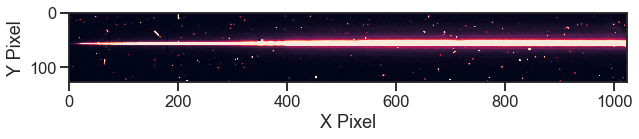

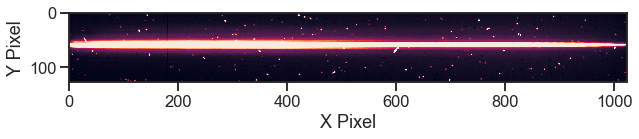

In [13]:
# check on one of the data frames (first part of data) - 430 first and then 750
plt.figure(figsize = (10,10))
im = plt.imshow(data_430[0][0])
im.set_clim(0,150)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,10))
im = plt.imshow(data_750[0][0])
im.set_clim(0,150)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

In [14]:
# initialize a list for and then create traces for each of the data frames
trace_list_430 = []
for i in data_430[0]:
    # trace wants xi, xf, and an initial y guess - these are numbers I just chose from some testing
    # it can be seen above this just corresponds to the strongest flux
    # this function is fast so you can test for yourself if these values don't work!
    trace = trace_spectrum(i, 100,1000,60)
    trace_list_430.append(trace)

trace_list_750 = []
for i in data_750[0]:
    # trace wants xi, xf, and an initial y guess - these are numbers I just chose from some testing
    # it can be seen above this just corresponds to the strongest flux
    # this function is fast so you can test for yourself if these values don't work!
    trace = trace_spectrum(i, 100,1000,60)
    trace_list_750.append(trace)

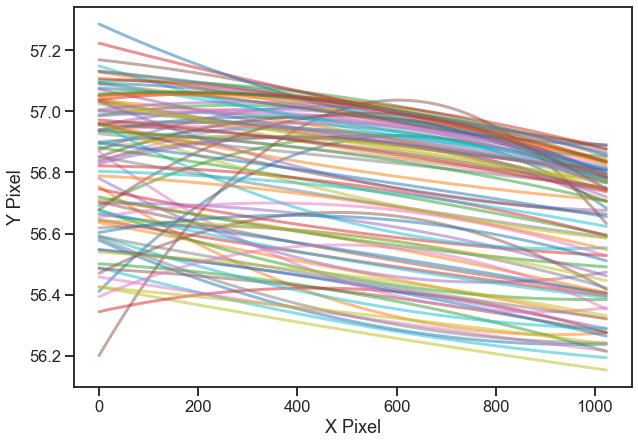

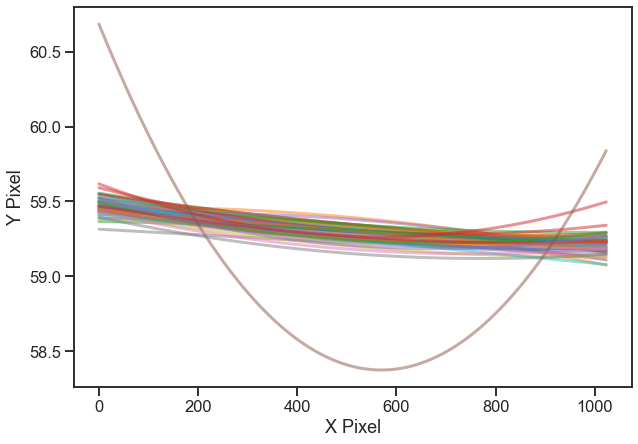

In [15]:
# fit a polynomial to the traces - I just use a second-order chebyshev
# and i fit it over the whole length of the data frame instead of just what was use for the fit
trace_fit_430 = []
plt.figure(figsize = (10,7))
for j in trace_list_430:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    # plotting just to check everything looks okay
    plt.plot(np.arange(len(data_430[0][0][0])),chebyshev.chebval(np.arange(len(data_430[0][0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(data_430[0][0][0])),chebyshev.chebval(np.arange(len(data_430[0][0][0])),coeffs1)]
    trace_fit_430.append(trace)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

# fit a polynomial to the traces - I just use a second-order chebyshev
# and i fit it over the whole length of the data frame instead of just what was use for the fit
trace_fit_750 = []
plt.figure(figsize = (10,7))
for j in trace_list_750:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    # plotting just to check everything looks okay
    plt.plot(np.arange(len(data_750[0][0][0])),chebyshev.chebval(np.arange(len(data_750[0][0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(data_750[0][0][0])),chebyshev.chebval(np.arange(len(data_750[0][0][0])),coeffs1)]
    trace_fit_750.append(trace)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

# there's maybe some outliers here, but this is just an initial trace to feed into the cleaning function
# so we don't worry about it - should subside once the cosmic rays are cleaned

In [16]:
# orbit lengths (the nonzero values of course)
data_430[5]

[0, 8, 0, 10, 0, 10, 0, 10, 0, 10, 0, 8, 0, 10, 0, 10, 0, 10, 0, 10, 0]

In [17]:
# now to clean the data - default is all steps on (dq, difference_correct, hc_correct, spline_correct)
# i'm breaking up the orbits manually here, not sure what the best way to do this automatically is yet
cleaned_1_430 = clean_data(data_430[0][:4], dqs = data_430[3][:4], traces = trace_fit_430[:4])
cleaned_2_430= clean_data(data_430[0][4:8], dqs = data_430[3][4:8], traces = trace_fit_430[3:7])

cleaned_3_430 = clean_data(data_430[0][8:12], dqs = data_430[3][8:12], traces = trace_fit_430[8:12])
cleaned_4_430 = clean_data(data_430[0][12:15], dqs = data_430[3][12:15], traces = trace_fit_430[12:15])
cleaned_5_430 = clean_data(data_430[0][15:18], dqs = data_430[3][15:18], traces = trace_fit_430[15:18])


cleaned_6_430 = clean_data(data_430[0][18:22], dqs = data_430[3][18:22], traces = trace_fit_430[18:22])
cleaned_7_430 = clean_data(data_430[0][22:25], dqs = data_430[3][22:25], traces = trace_fit_430[22:25])
cleaned_8_430 = clean_data(data_430[0][25:28], dqs = data_430[3][25:28], traces = trace_fit_430[25:28])

cleaned_9_430 = clean_data(data_430[0][28:32], dqs = data_430[3][28:32], traces = trace_fit_430[28:32])
cleaned_10_430 = clean_data(data_430[0][32:35], dqs = data_430[3][32:35], traces = trace_fit_430[32:35])
cleaned_11_430 = clean_data(data_430[0][35:38], dqs = data_430[3][35:38], traces = trace_fit_430[35:38])

cleaned_12_430 = clean_data(data_430[0][38:42], dqs = data_430[3][38:42], traces = trace_fit_430[38:42])
cleaned_13_430 = clean_data(data_430[0][42:45], dqs = data_430[3][42:45], traces = trace_fit_430[42:45])
cleaned_14_430 = clean_data(data_430[0][45:48], dqs = data_430[3][45:48], traces = trace_fit_430[45:48])

Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting differenc

In [18]:
cleaned_21_430 = clean_data(data_430[0][48:52], dqs = data_430[3][48:52], traces = trace_fit_430[48:52])
cleaned_22_430= clean_data(data_430[0][52:56], dqs = data_430[3][52:56], traces = trace_fit_430[52:56])

cleaned_23_430 = clean_data(data_430[0][56:60], dqs = data_430[3][56:60], traces = trace_fit_430[56:60])
cleaned_24_430 = clean_data(data_430[0][60:63], dqs = data_430[3][60:63], traces = trace_fit_430[60:63])
cleaned_25_430 = clean_data(data_430[0][63:66], dqs = data_430[3][63:66], traces = trace_fit_430[63:66])

cleaned_26_430 = clean_data(data_430[0][66:70], dqs = data_430[3][66:70], traces = trace_fit_430[66:70])
cleaned_27_430 = clean_data(data_430[0][70:73], dqs = data_430[3][70:73], traces = trace_fit_430[70:73])
cleaned_28_430 = clean_data(data_430[0][73:76], dqs = data_430[3][73:76], traces = trace_fit_430[73:76])

cleaned_29_430 = clean_data(data_430[0][76:80], dqs = data_430[3][76:80], traces = trace_fit_430[76:80])
cleaned_210_430 = clean_data(data_430[0][80:83], dqs = data_430[3][80:83], traces = trace_fit_430[80:83])
cleaned_211_430 = clean_data(data_430[0][83:86], dqs = data_430[3][83:86], traces = trace_fit_430[83:86])

cleaned_212_430 = clean_data(data_430[0][86:90], dqs = data_430[3][86:90], traces = trace_fit_430[86:90])
cleaned_213_430 = clean_data(data_430[0][90:93], dqs = data_430[3][90:93], traces = trace_fit_430[90:93])
cleaned_214_430 = clean_data(data_430[0][93:96], dqs = data_430[3][93:96], traces = trace_fit_430[93:96])

Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting differenc

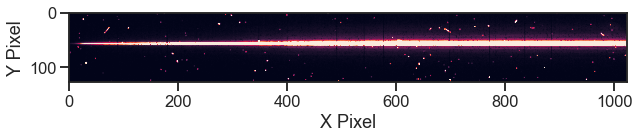

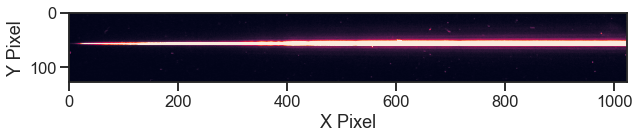

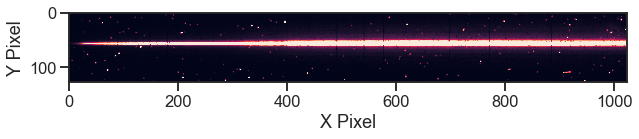

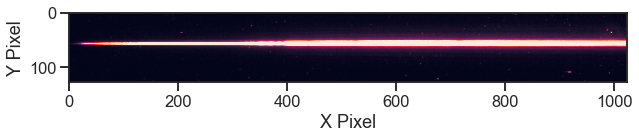

In [20]:
# comparison between the original and the cleaned image
# can easily see the lack of cosmic rays/bad pixels and removal of bad columns
plt.figure(figsize = (10,10))
im = plt.imshow(data_430[0][1])
im.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()
plt.figure(figsize = (10,10))
cim = plt.imshow(cleaned_1_430[1])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,10))
im = plt.imshow(data_430[0][-1])
im.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()
plt.figure(figsize = (10,10))
cim = plt.imshow(cleaned_214_430[-1])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

In [21]:
data_750[5]

[0, 8, 0, 10, 0, 10, 0, 10, 0, 10]

In [22]:
# now to clean the data - default is all steps on (dq, difference_correct, hc_correct, spline_correct)
# i'm breaking up the orbits manually here, not sure what the best way to do this automatically is yet
cleaned_1_750 = clean_data(data_750[0][:4], dqs = data_750[3][:4], traces = trace_fit_750[:4])
cleaned_2_750= clean_data(data_750[0][4:8], dqs = data_750[3][4:8], traces = trace_fit_750[3:7])

cleaned_3_750 = clean_data(data_750[0][8:12], dqs = data_750[3][8:12], traces = trace_fit_750[8:12])
cleaned_4_750 = clean_data(data_750[0][12:15], dqs = data_750[3][12:15], traces = trace_fit_750[12:15])
cleaned_5_750 = clean_data(data_750[0][15:18], dqs = data_750[3][15:18], traces = trace_fit_750[15:18])

cleaned_6_750 = clean_data(data_750[0][18:22], dqs = data_750[3][18:22], traces = trace_fit_750[18:22])
cleaned_7_750 = clean_data(data_750[0][22:25], dqs = data_750[3][22:25], traces = trace_fit_750[22:25])
cleaned_8_750 = clean_data(data_750[0][25:28], dqs = data_750[3][25:28], traces = trace_fit_750[25:28])

cleaned_9_750 = clean_data(data_750[0][28:32], dqs = data_750[3][28:32], traces = trace_fit_750[28:32])
cleaned_10_750 = clean_data(data_750[0][32:35], dqs = data_750[3][32:35], traces = trace_fit_750[32:35])
cleaned_11_750 = clean_data(data_750[0][35:38], dqs = data_750[3][35:38], traces = trace_fit_750[35:38])

cleaned_12_750 = clean_data(data_750[0][38:42], dqs = data_750[3][38:42], traces = trace_fit_750[38:42])
cleaned_13_750 = clean_data(data_750[0][42:45], dqs = data_750[3][42:45], traces = trace_fit_750[42:45])
cleaned_14_750 = clean_data(data_750[0][45:48], dqs = data_750[3][45:48], traces = trace_fit_750[45:48])

Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting difference_correct.
difference_correct complete.
Starting hc_correct.
hc_correct complete.
Starting spline_correct.
spline_correct complete.
Starting overwrite of marked pixels.
Done!
Starting dq_correct.
dq_correct complete.
Starting differenc

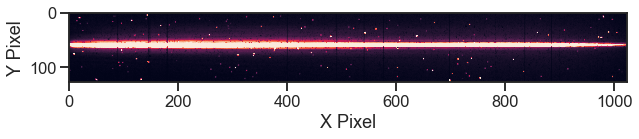

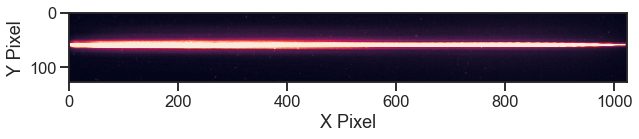

In [23]:
plt.figure(figsize = (10,10))
cim = plt.imshow(data_750[0][1])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()
plt.figure(figsize = (10,10))
cim = plt.imshow(cleaned_1_750[1])
cim.set_clim(0,200)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

In [24]:
# just putting all of the cleaned files into one list
transit_750_cleaned = [*cleaned_1_750, *cleaned_2_750, *cleaned_3_750, *cleaned_4_750, *cleaned_5_750, *cleaned_6_750, *cleaned_7_750, *cleaned_8_750, *cleaned_9_750, *cleaned_10_750, *cleaned_11_750, *cleaned_12_750, *cleaned_13_750, *cleaned_14_750]
transit_430_cleaned = [*cleaned_1_430, *cleaned_2_430, *cleaned_3_430, *cleaned_4_430, *cleaned_5_430, *cleaned_6_430, *cleaned_7_430, *cleaned_8_430, *cleaned_9_430, *cleaned_10_430, *cleaned_11_430, *cleaned_12_430, *cleaned_13_430, *cleaned_14_430]
transit_430_2_cleaned = [*cleaned_21_430, *cleaned_22_430, *cleaned_23_430, *cleaned_24_430, *cleaned_25_430, *cleaned_26_430, *cleaned_27_430, *cleaned_28_430, *cleaned_29_430, *cleaned_210_430, *cleaned_211_430, *cleaned_212_430, *cleaned_213_430, *cleaned_214_430]

Frame 0


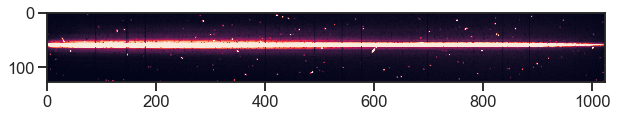

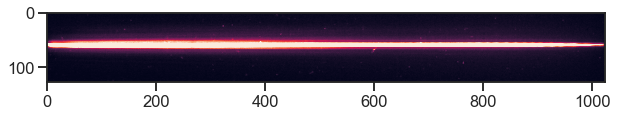

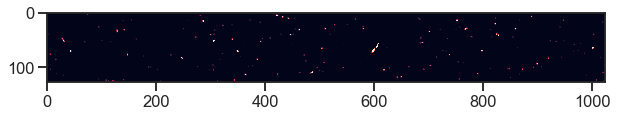

Frame 1


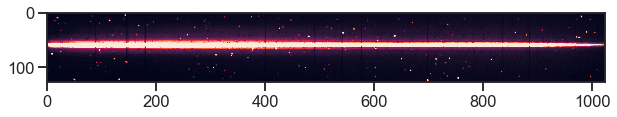

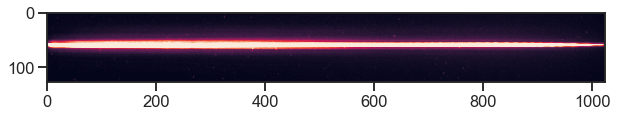

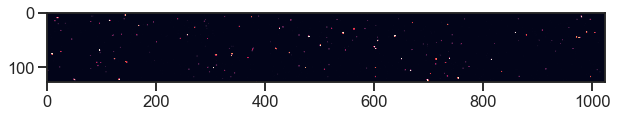

Frame 2


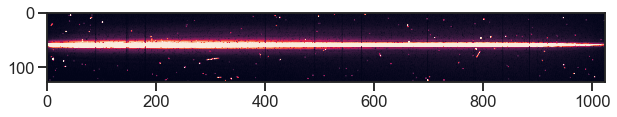

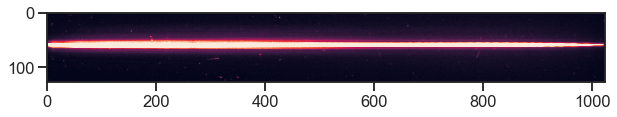

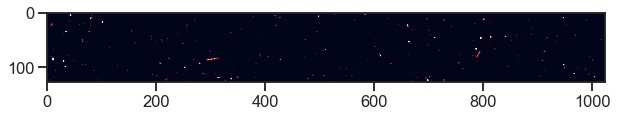

Frame 3


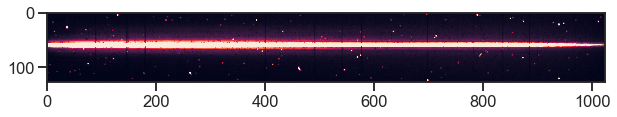

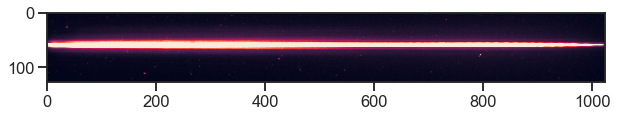

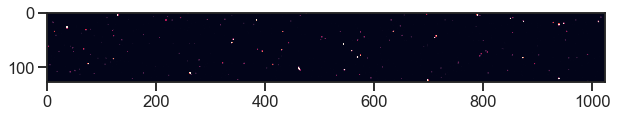

Frame 4


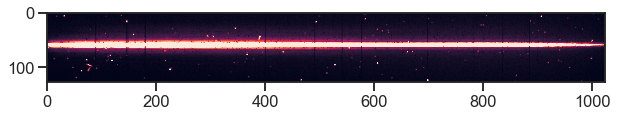

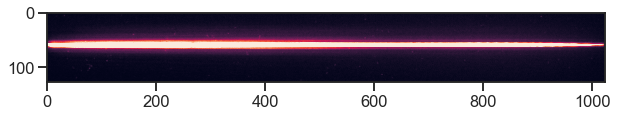

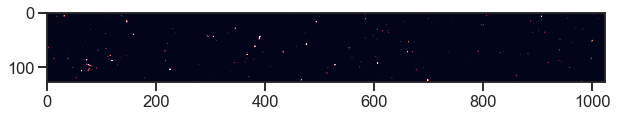

Frame 5


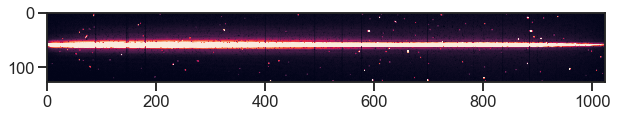

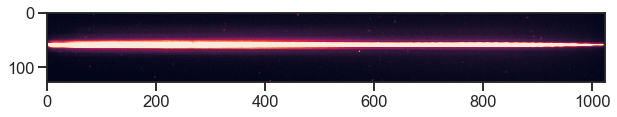

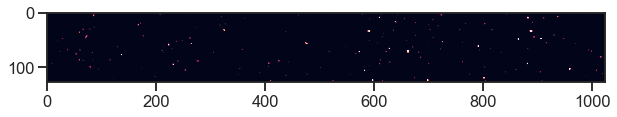

Frame 6


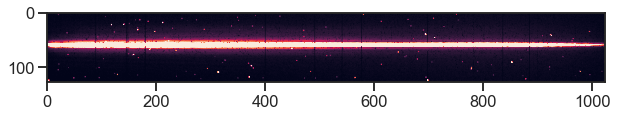

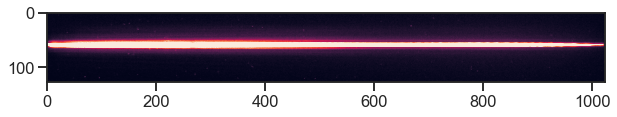

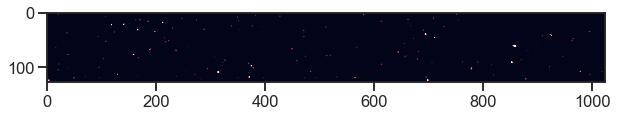

Frame 7


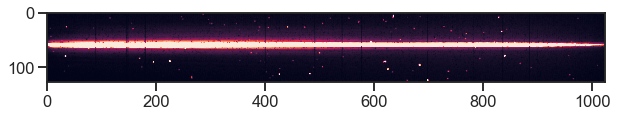

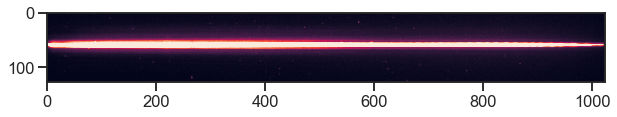

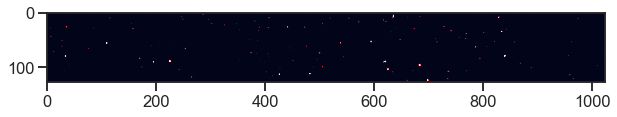

Frame 8


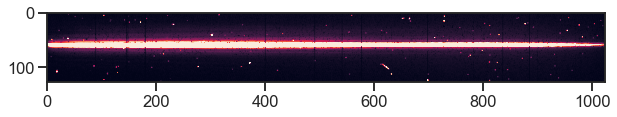

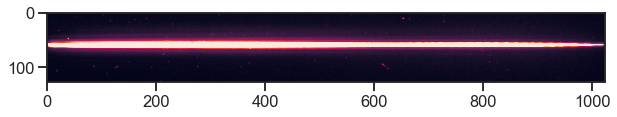

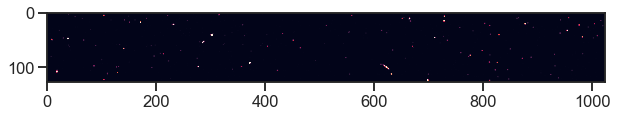

Frame 9


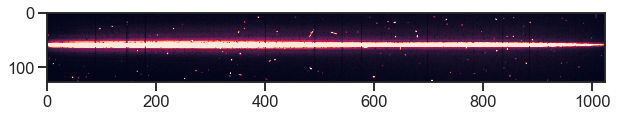

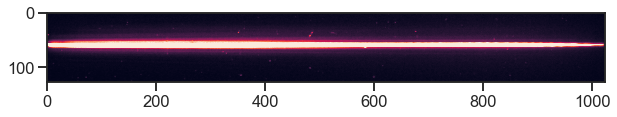

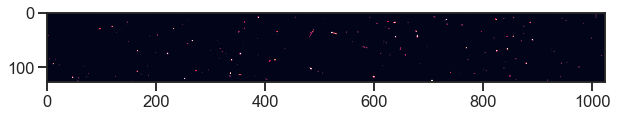

Frame 10


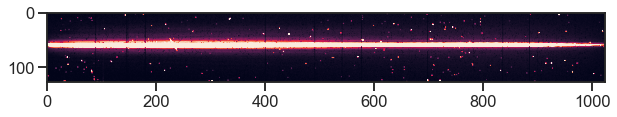

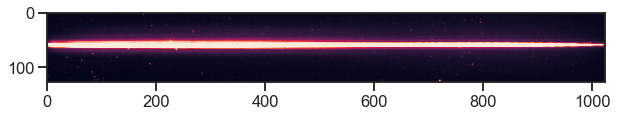

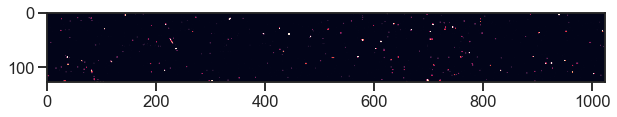

Frame 11


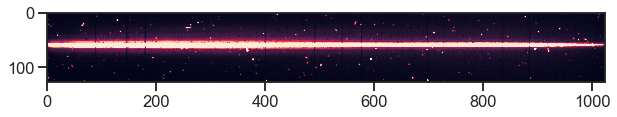

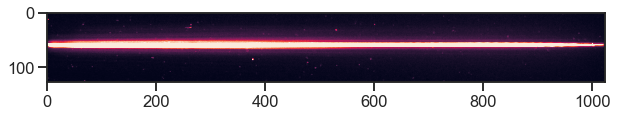

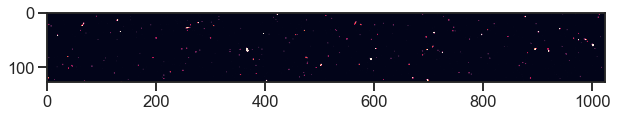

Frame 12


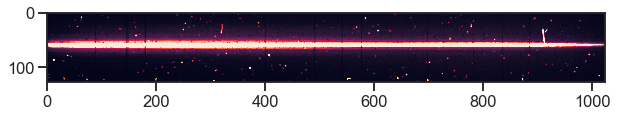

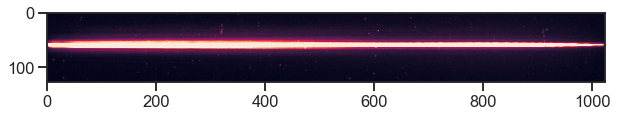

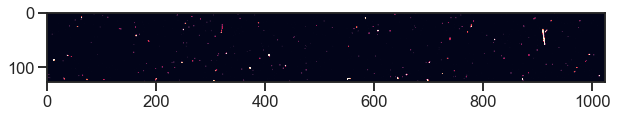

Frame 13


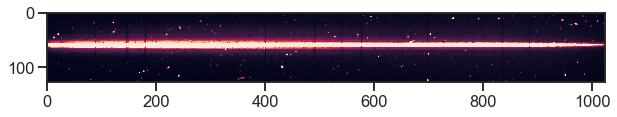

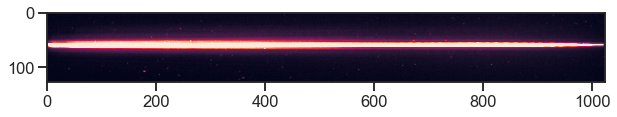

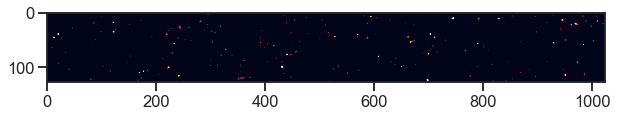

Frame 14


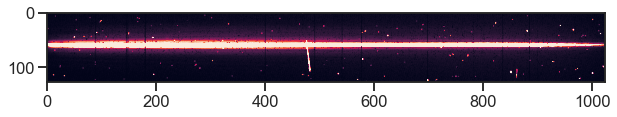

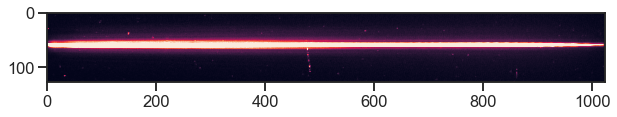

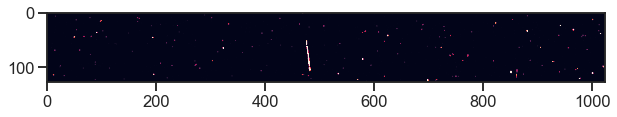

Frame 15


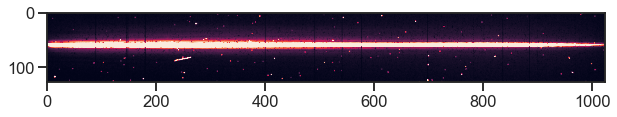

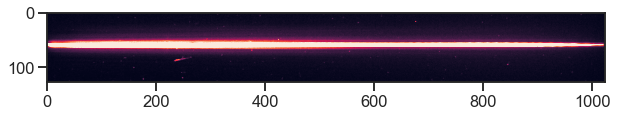

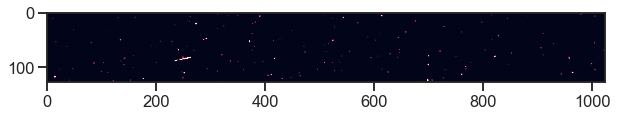

Frame 16


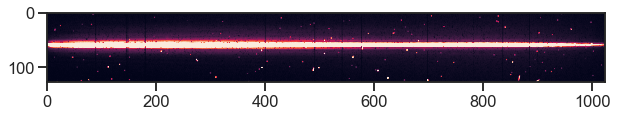

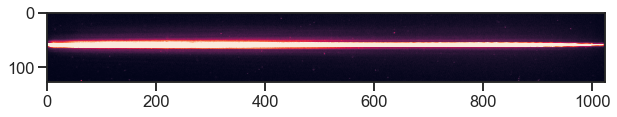

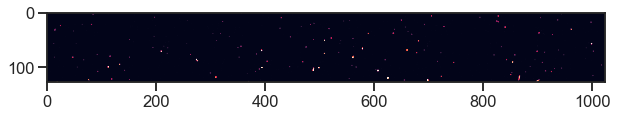

Frame 17


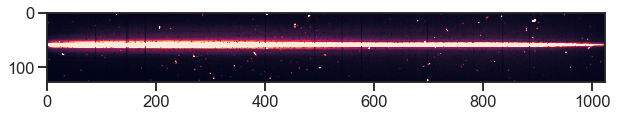

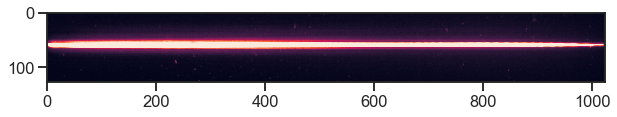

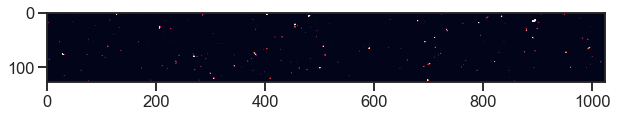

Frame 18


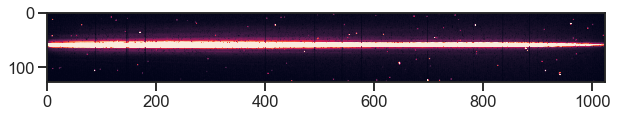

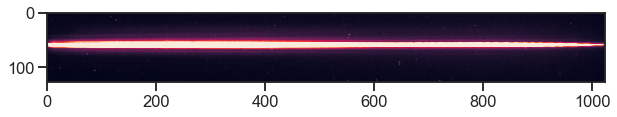

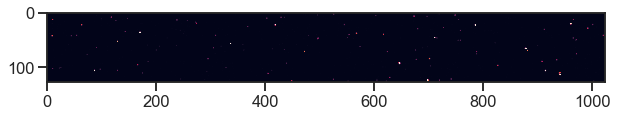

Frame 19


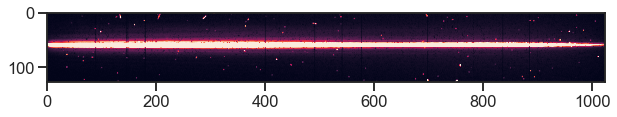

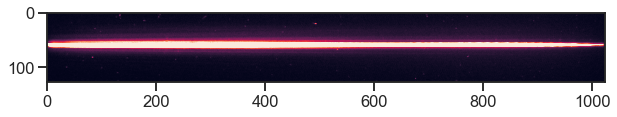

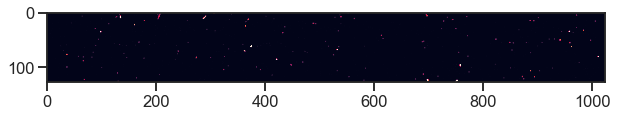

Frame 20


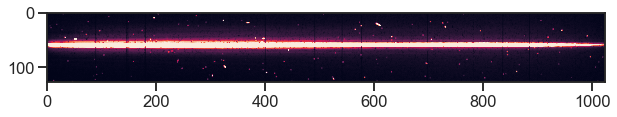

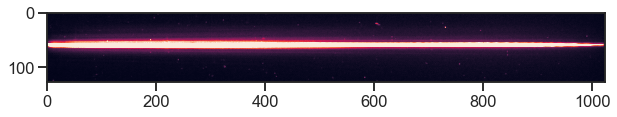

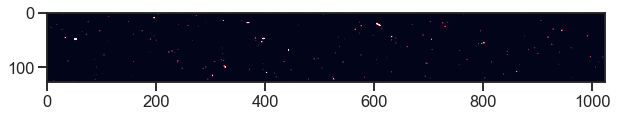

Frame 21


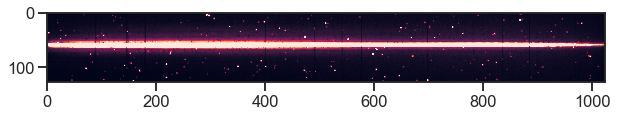

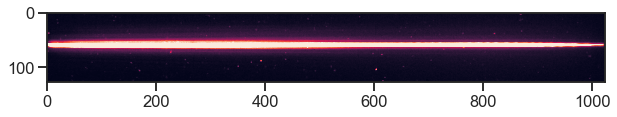

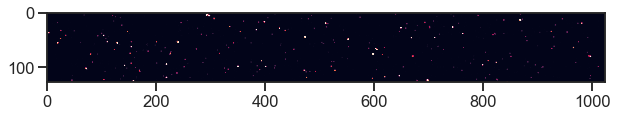

Frame 22


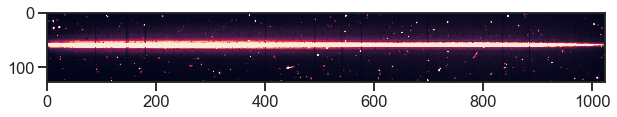

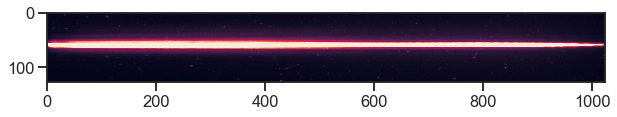

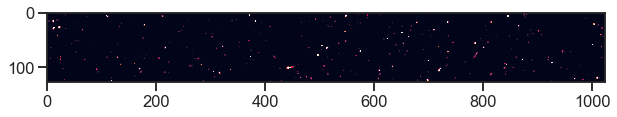

Frame 23


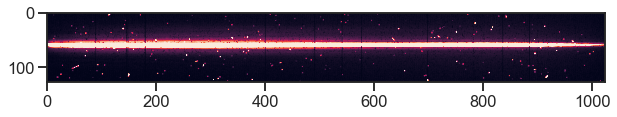

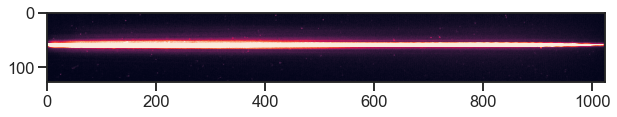

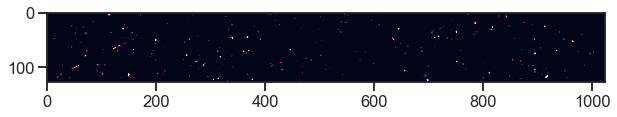

Frame 24


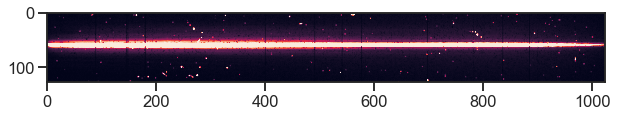

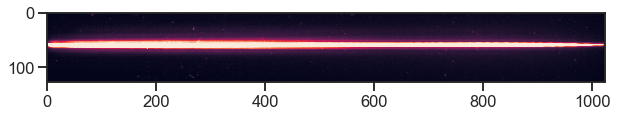

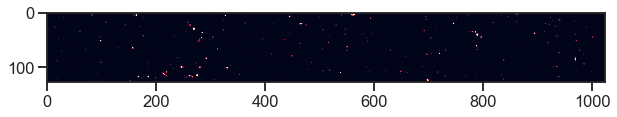

Frame 25


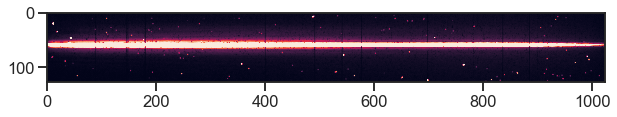

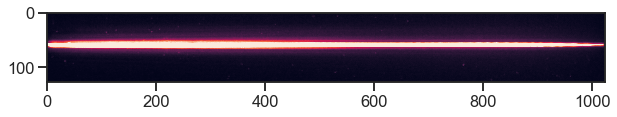

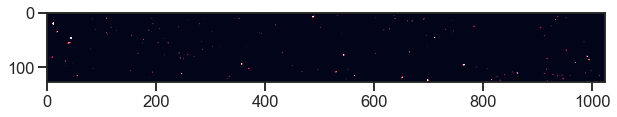

Frame 26


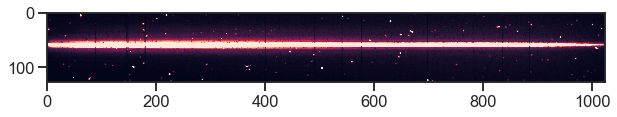

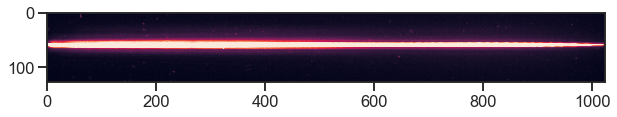

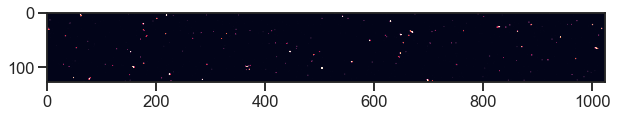

Frame 27


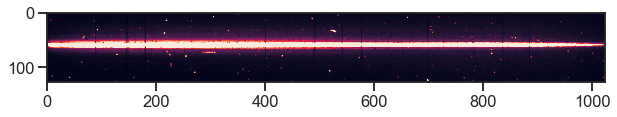

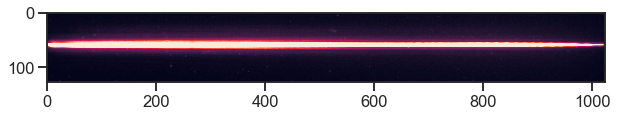

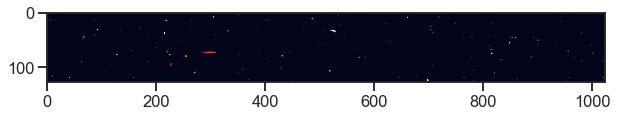

Frame 28


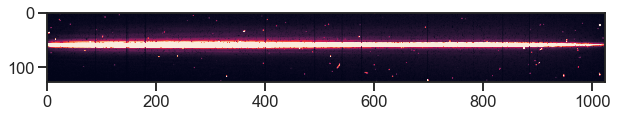

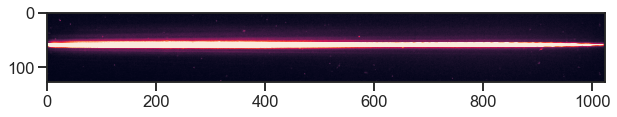

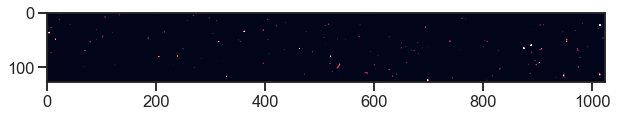

Frame 29


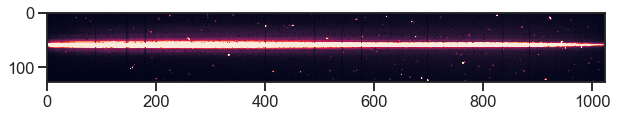

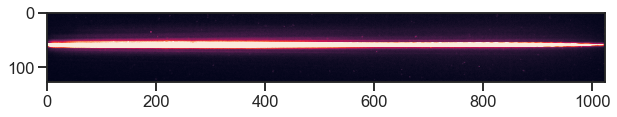

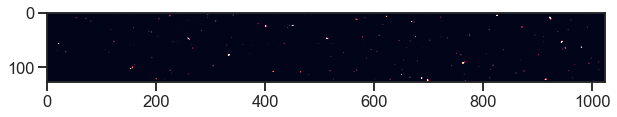

Frame 30


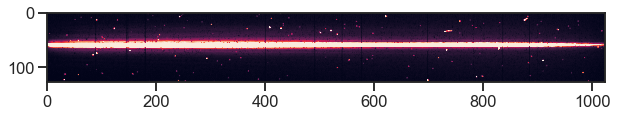

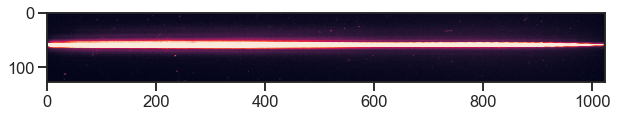

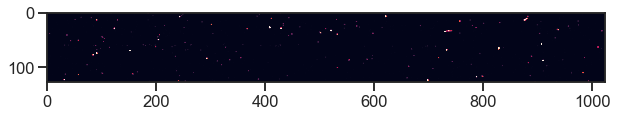

Frame 31


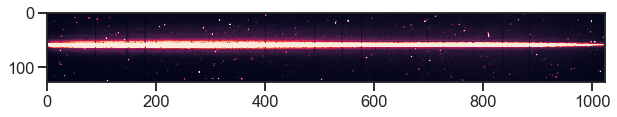

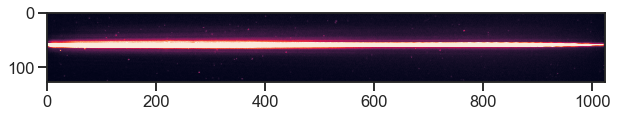

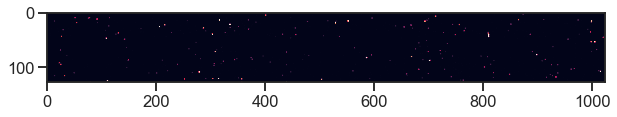

Frame 32


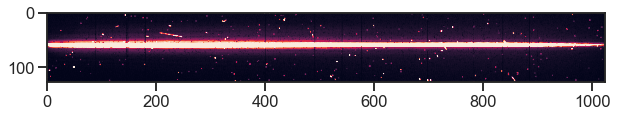

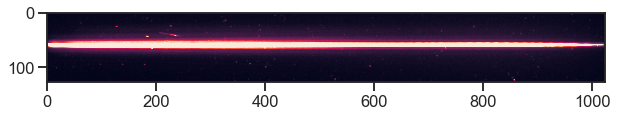

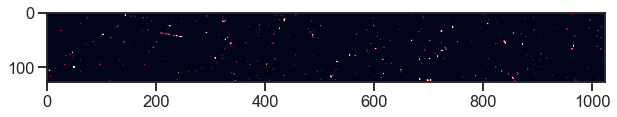

Frame 33


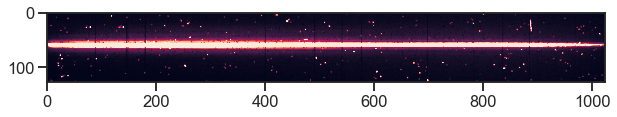

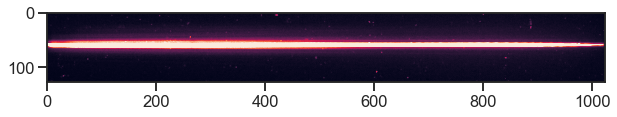

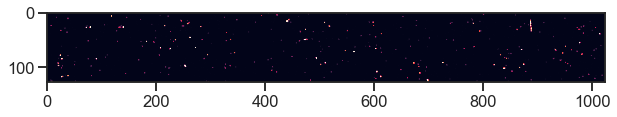

Frame 34


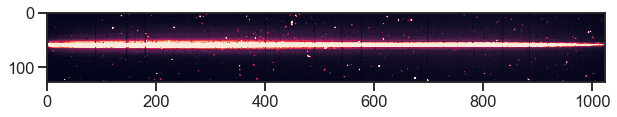

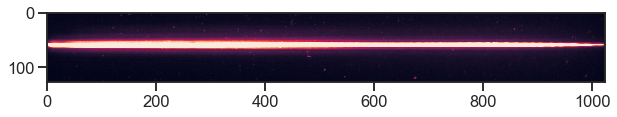

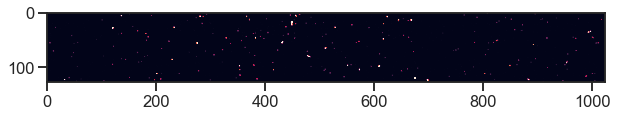

Frame 35


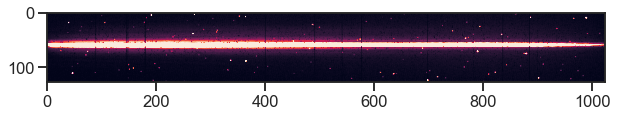

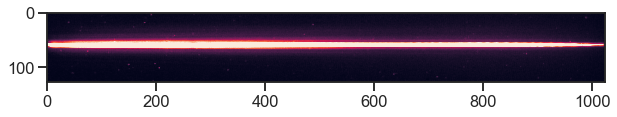

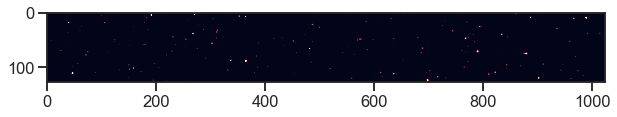

Frame 36


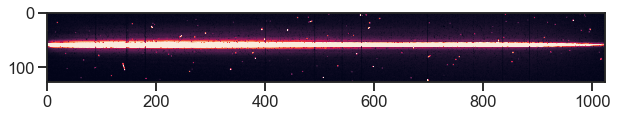

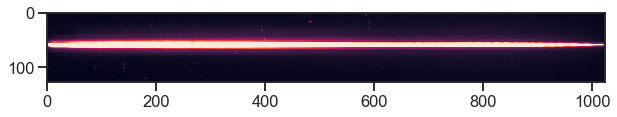

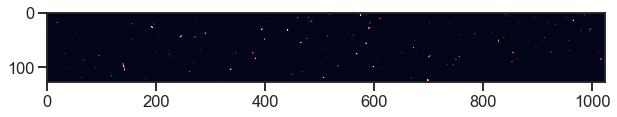

Frame 37


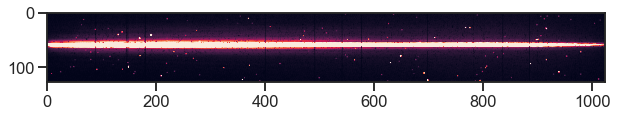

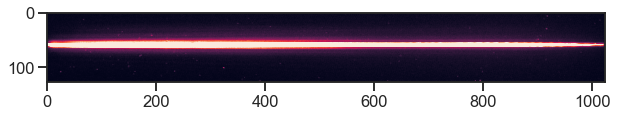

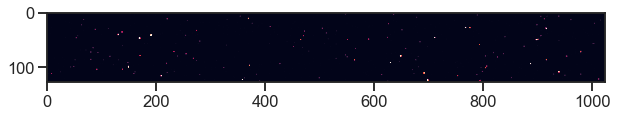

Frame 38


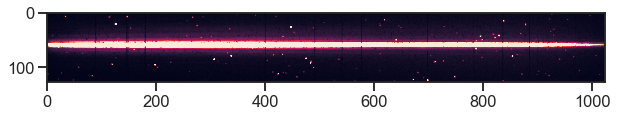

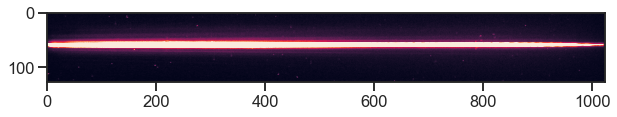

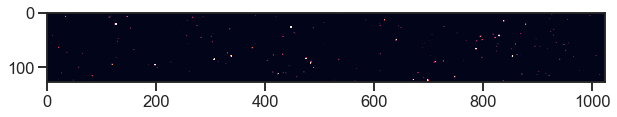

Frame 39


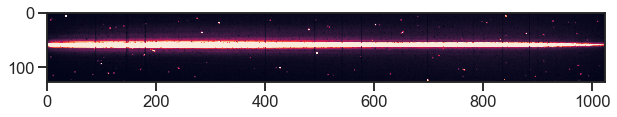

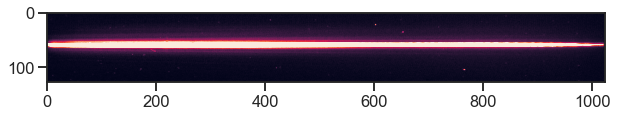

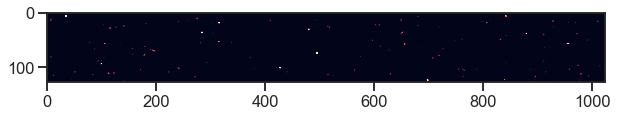

Frame 40


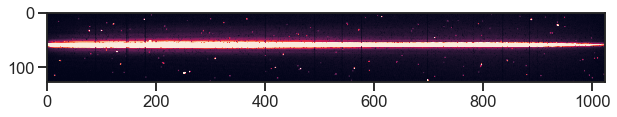

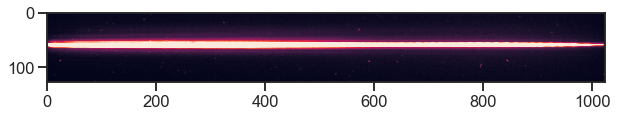

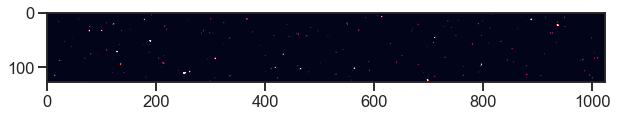

Frame 41


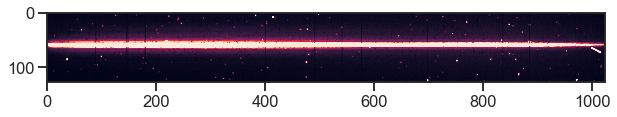

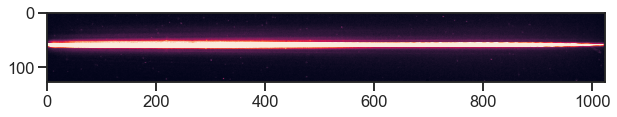

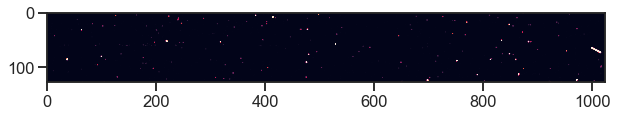

Frame 42


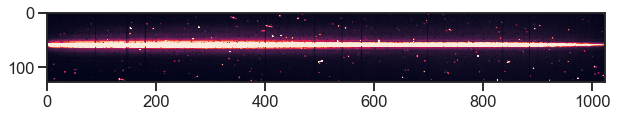

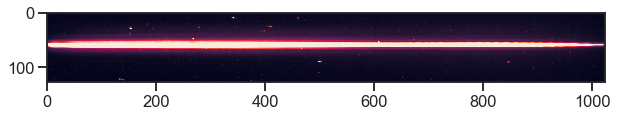

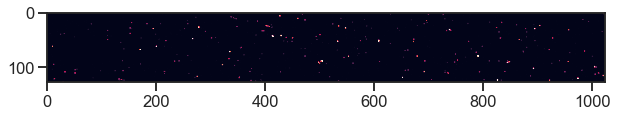

Frame 43


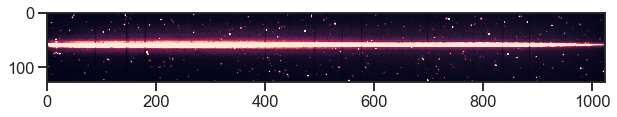

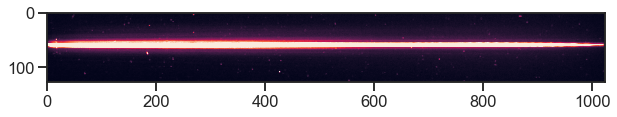

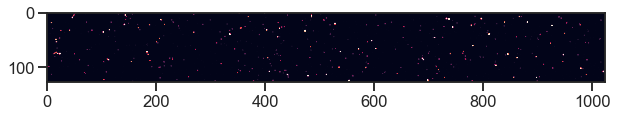

Frame 44


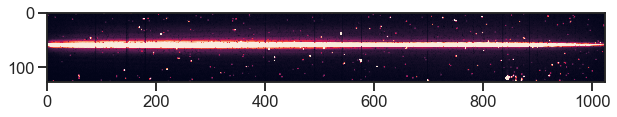

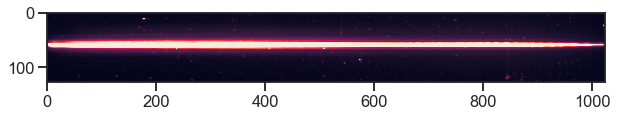

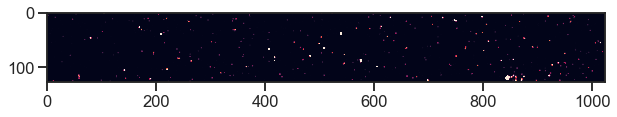

Frame 45


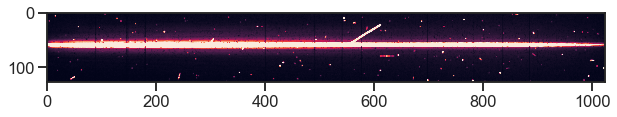

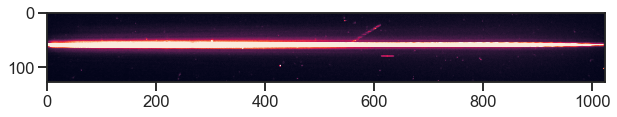

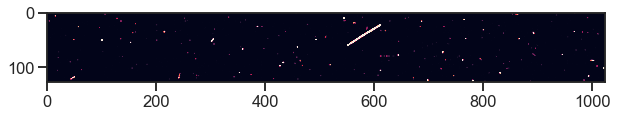

Frame 46


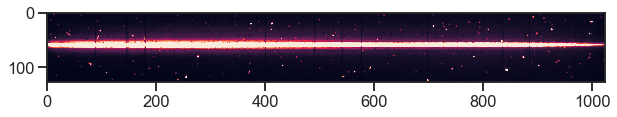

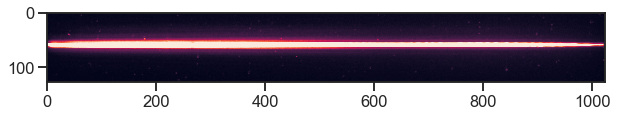

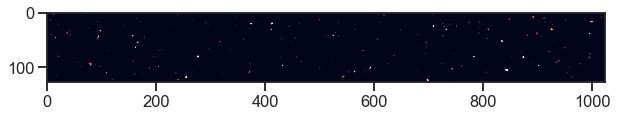

Frame 47


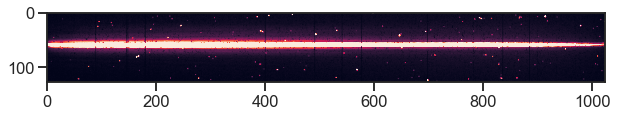

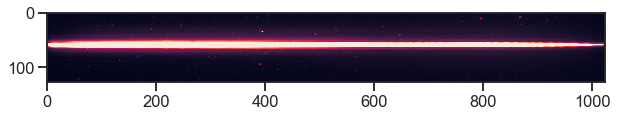

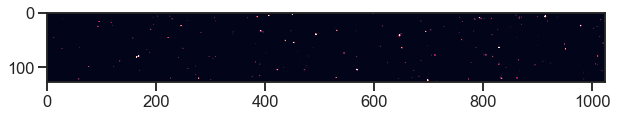

In [25]:
# let's look at the 750 data
for i in range(len(transit_750_cleaned)):
    print("Frame", i)
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_750[0][i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(transit_750_cleaned[i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_750[0][i]-transit_750_cleaned[i])
    im.set_clim(0,200)
    plt.show()
        

Frame 0


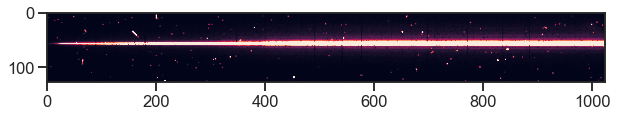

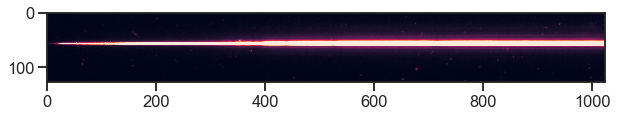

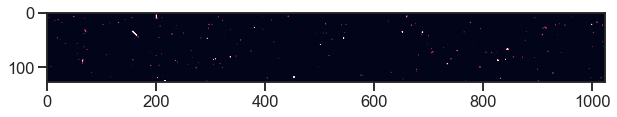

Frame 1


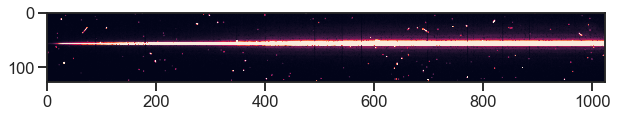

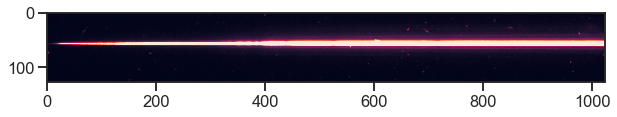

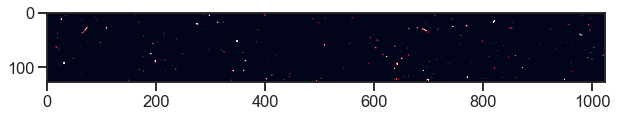

Frame 2


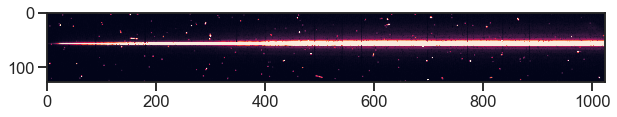

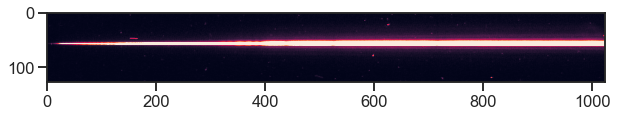

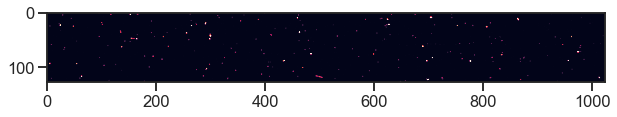

Frame 3


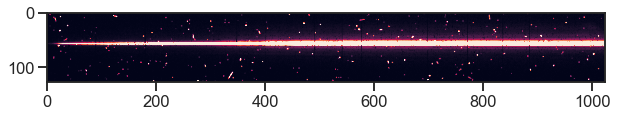

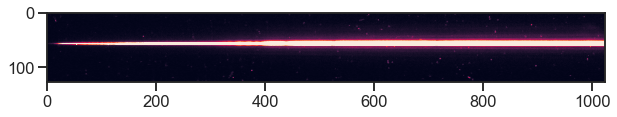

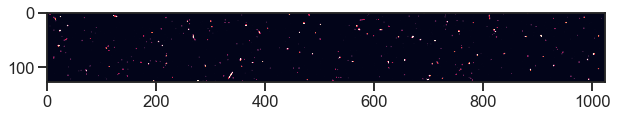

Frame 4


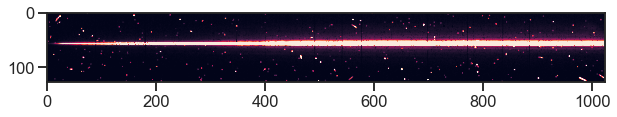

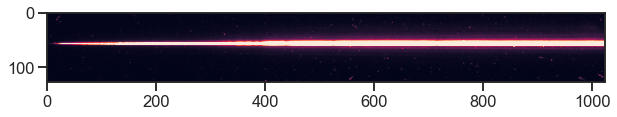

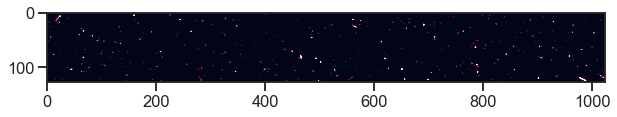

Frame 5


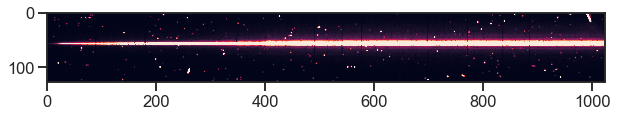

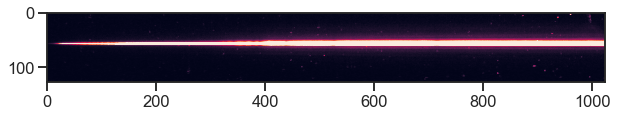

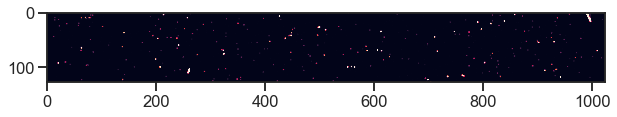

Frame 6


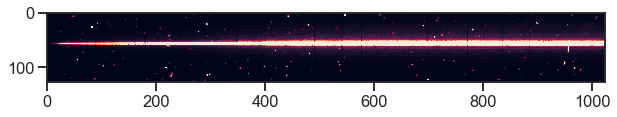

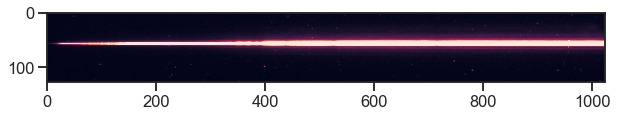

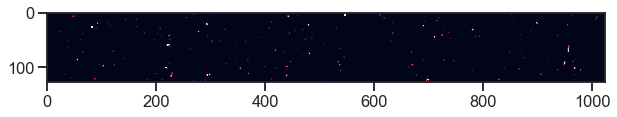

Frame 7


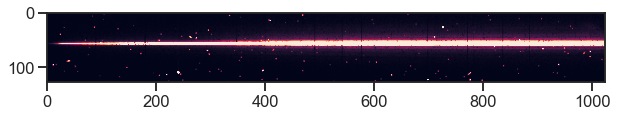

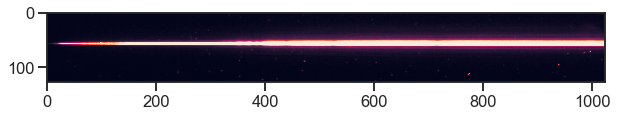

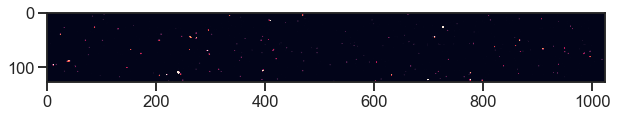

Frame 8


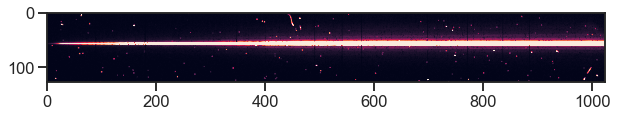

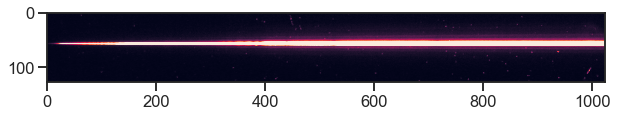

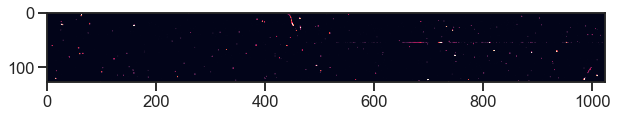

Frame 9


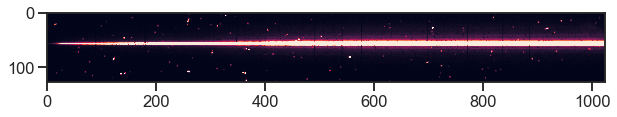

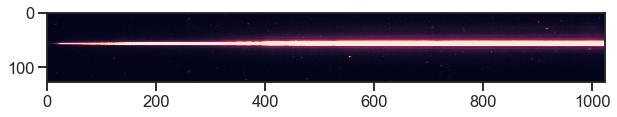

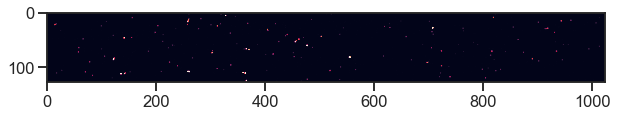

Frame 10


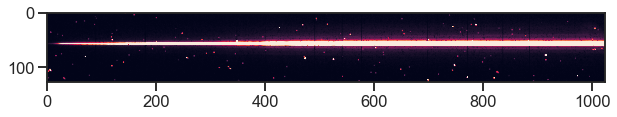

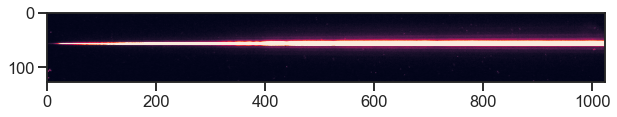

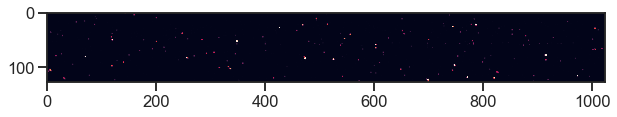

Frame 11


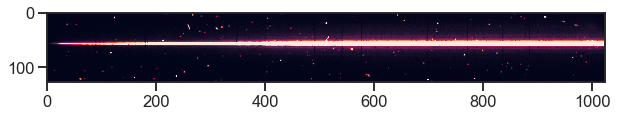

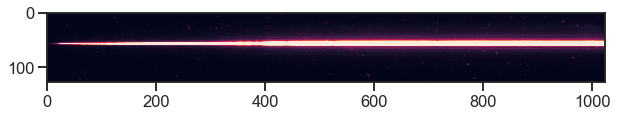

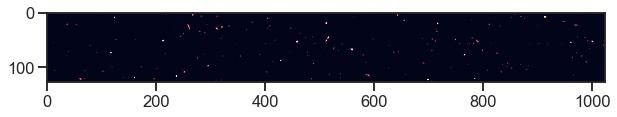

Frame 12


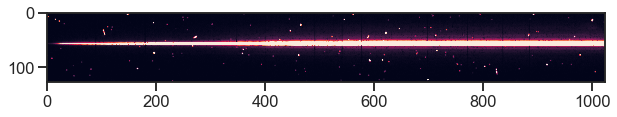

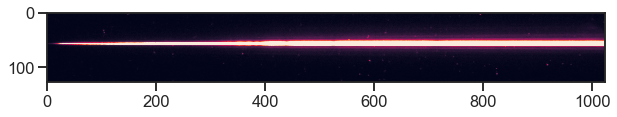

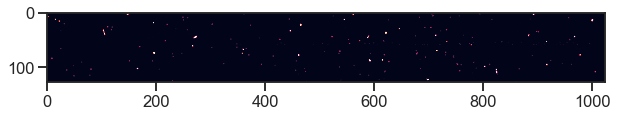

Frame 13


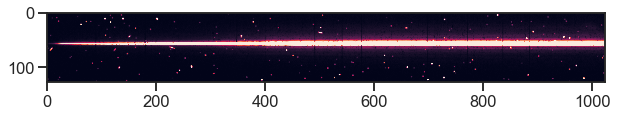

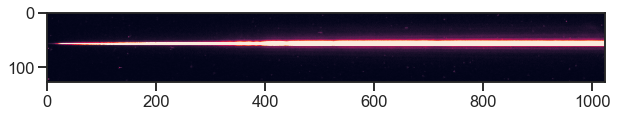

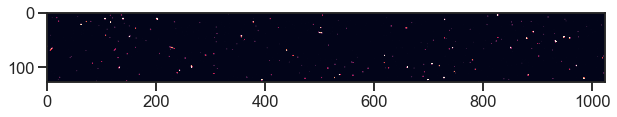

Frame 14


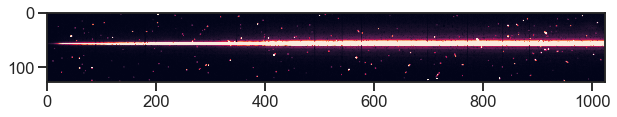

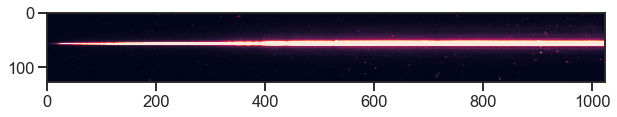

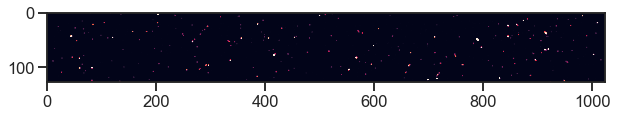

Frame 15


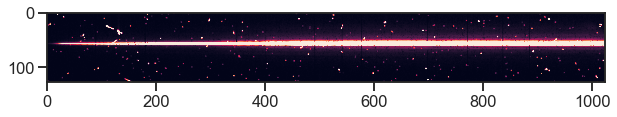

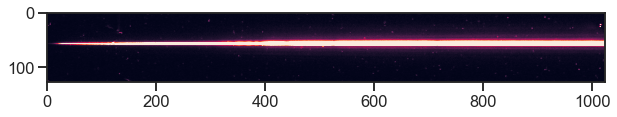

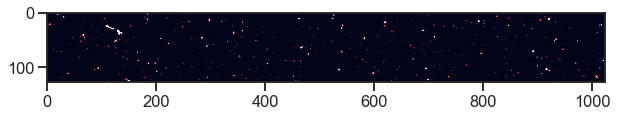

Frame 16


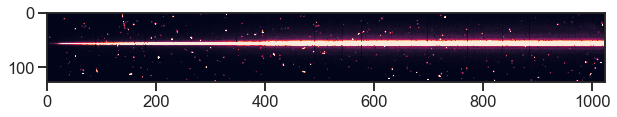

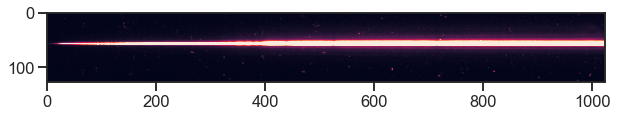

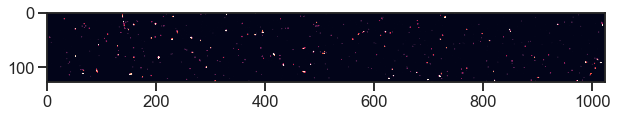

Frame 17


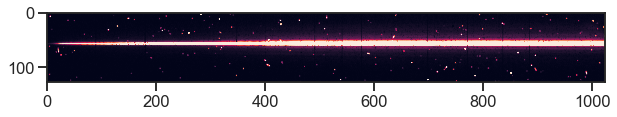

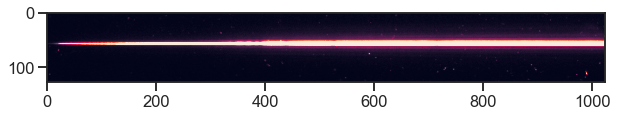

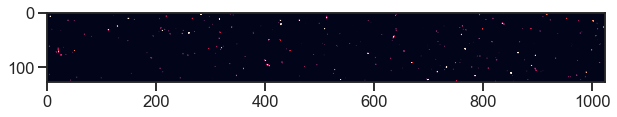

Frame 18


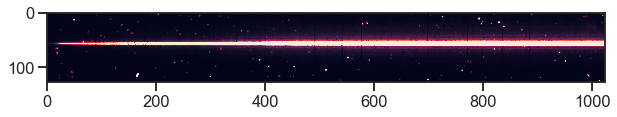

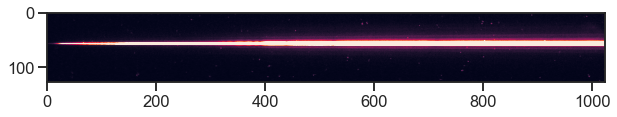

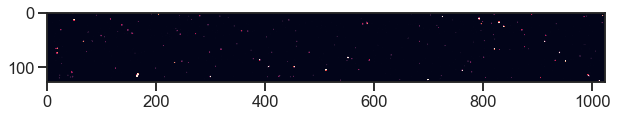

Frame 19


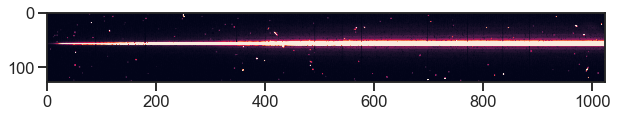

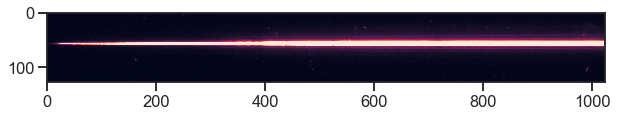

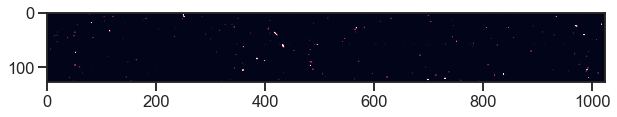

Frame 20


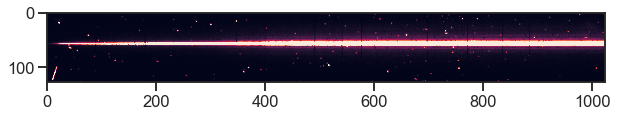

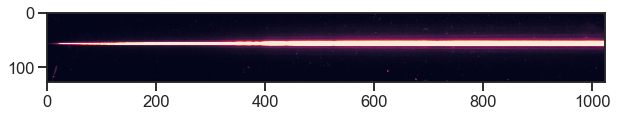

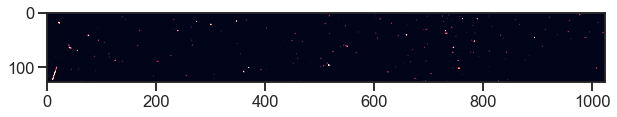

Frame 21


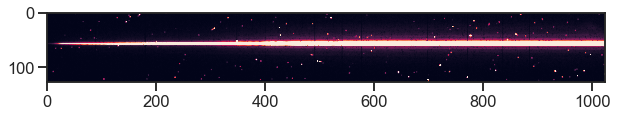

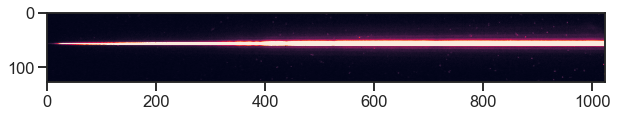

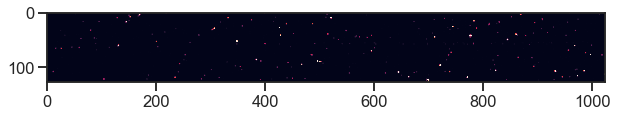

Frame 22


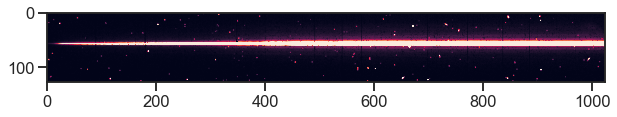

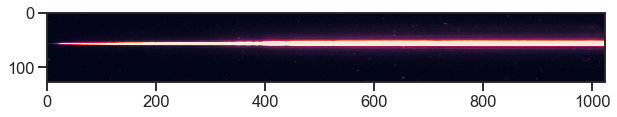

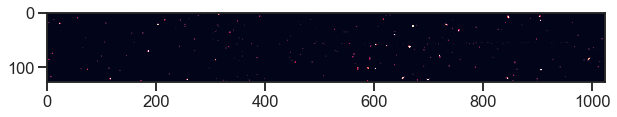

Frame 23


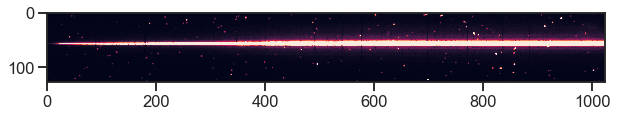

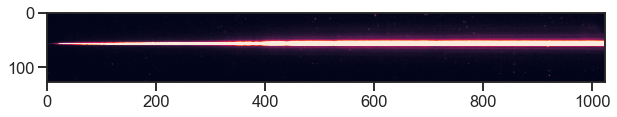

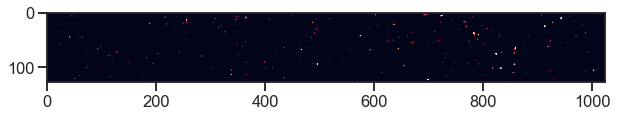

Frame 24


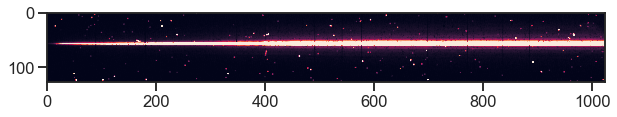

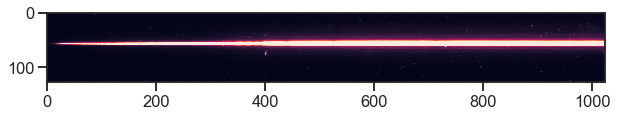

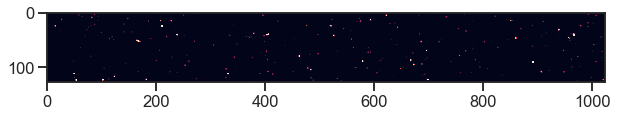

Frame 25


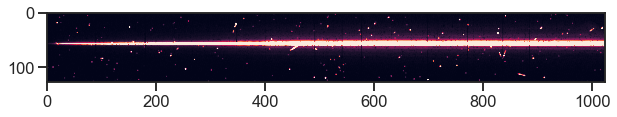

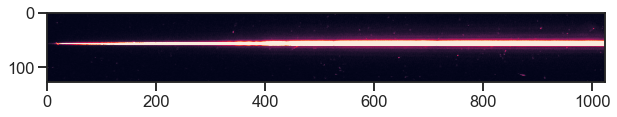

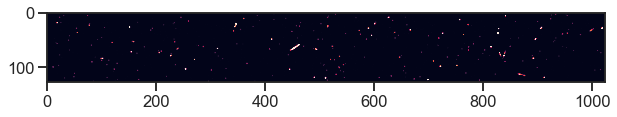

Frame 26


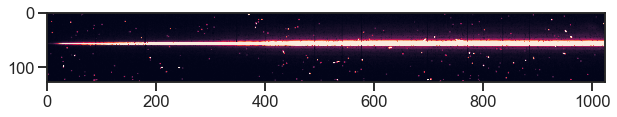

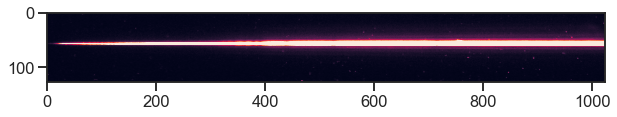

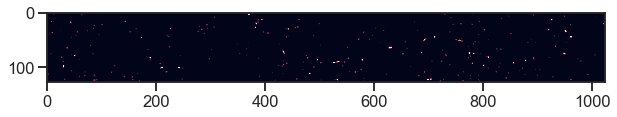

Frame 27


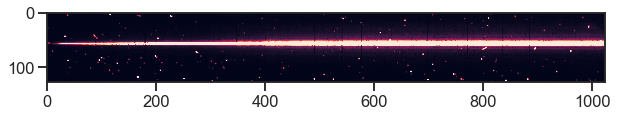

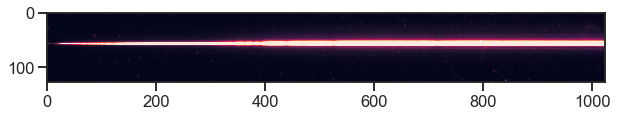

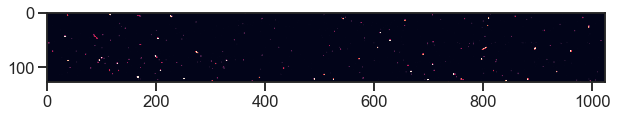

Frame 28


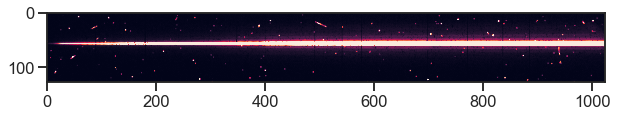

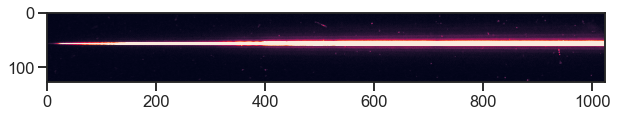

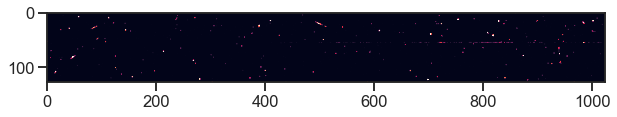

Frame 29


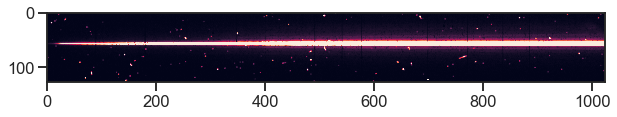

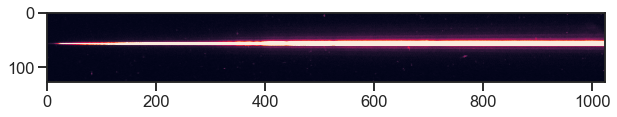

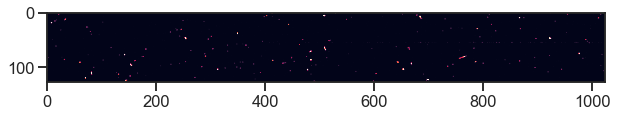

Frame 30


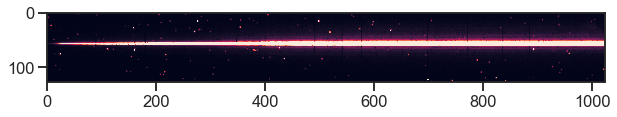

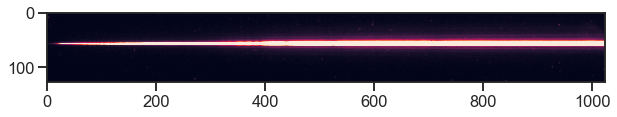

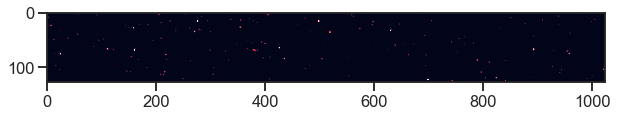

Frame 31


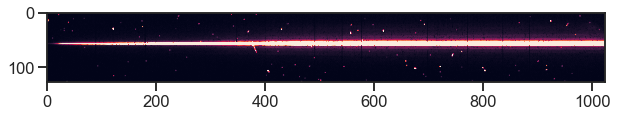

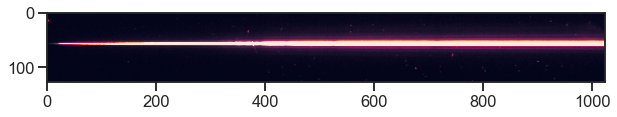

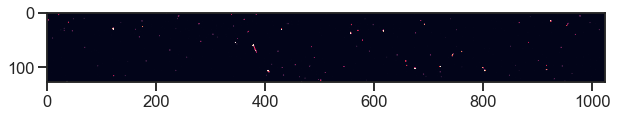

Frame 32


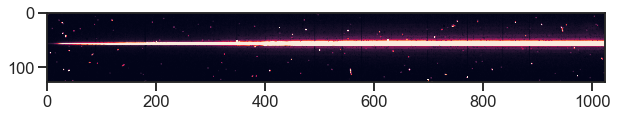

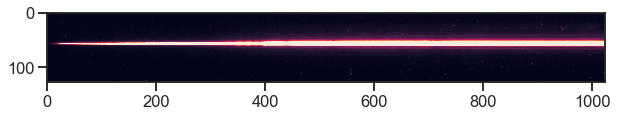

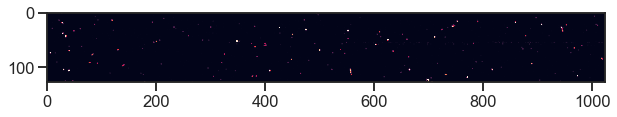

Frame 33


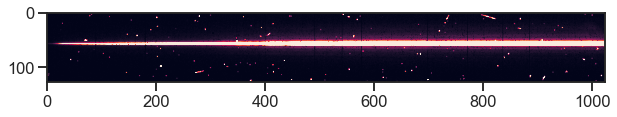

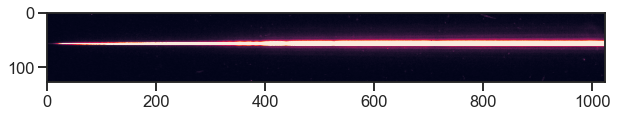

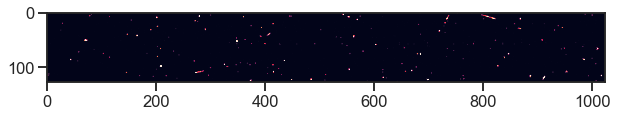

Frame 34


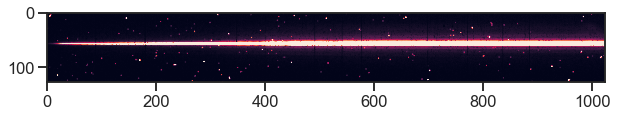

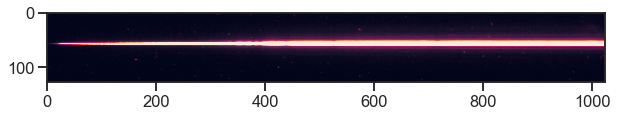

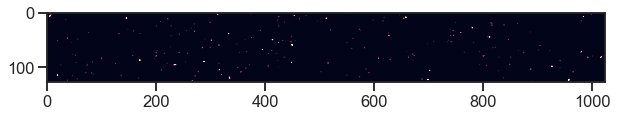

Frame 35


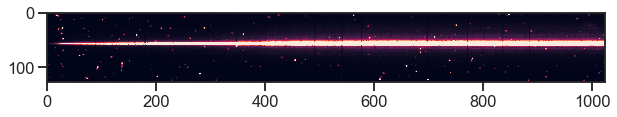

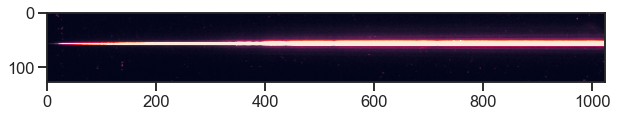

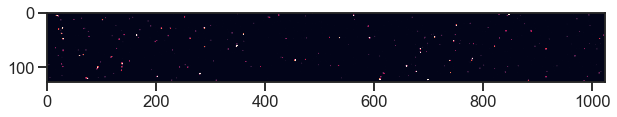

Frame 36


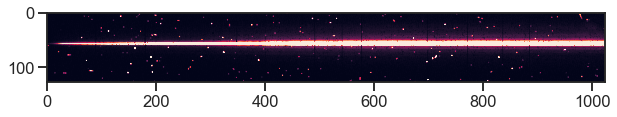

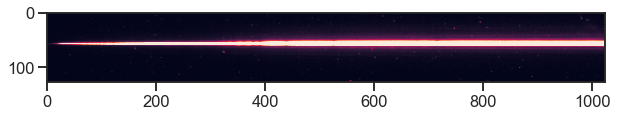

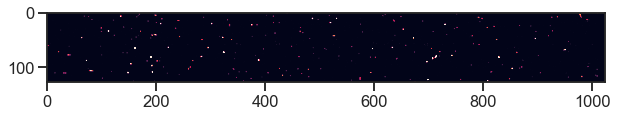

Frame 37


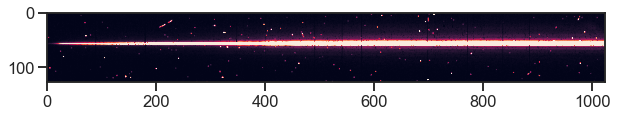

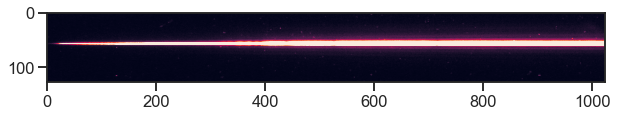

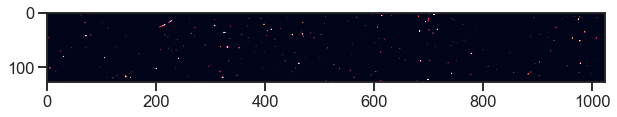

Frame 38


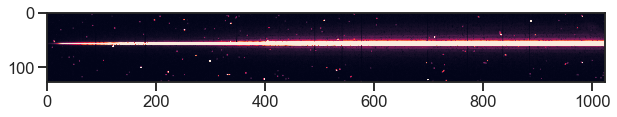

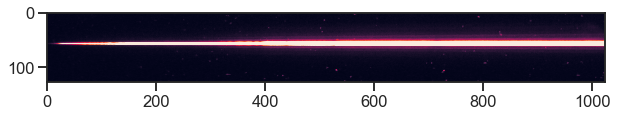

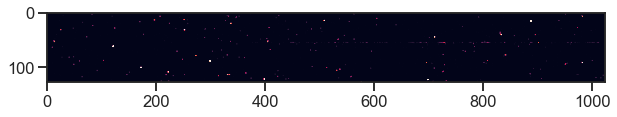

Frame 39


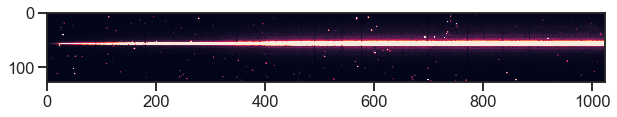

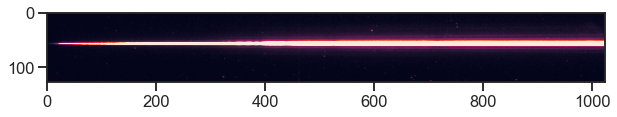

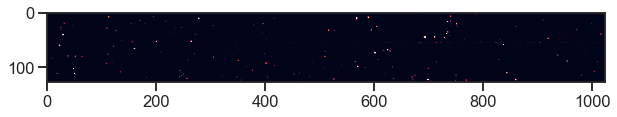

Frame 40


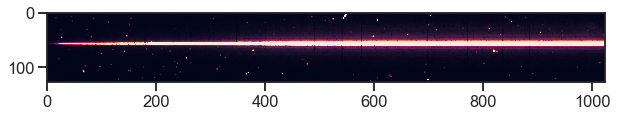

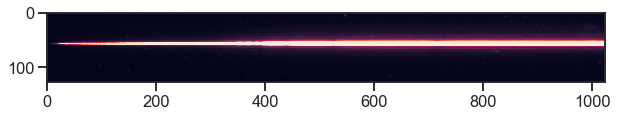

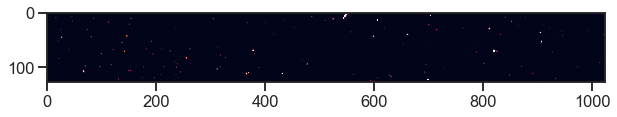

Frame 41


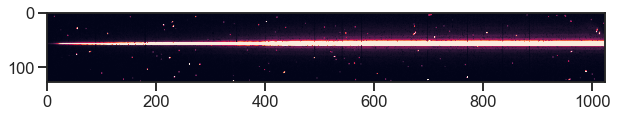

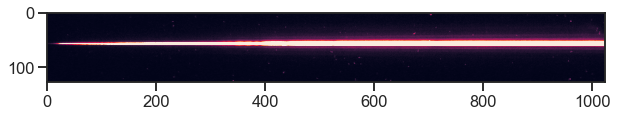

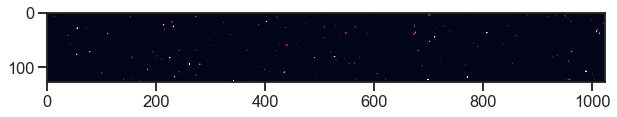

Frame 42


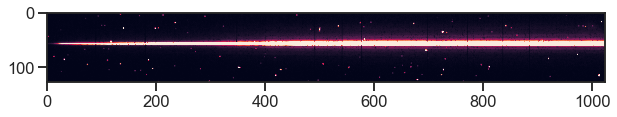

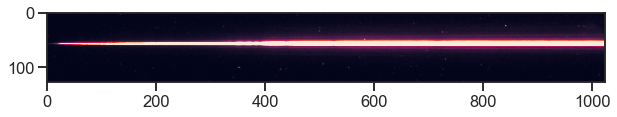

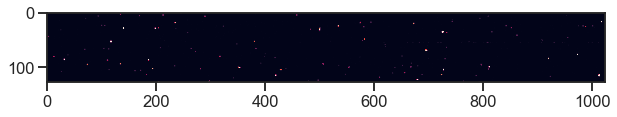

Frame 43


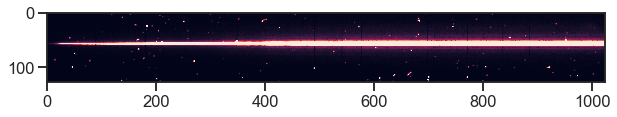

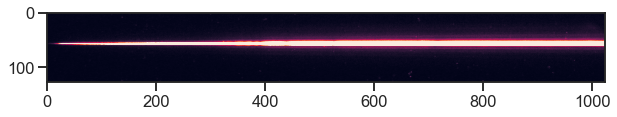

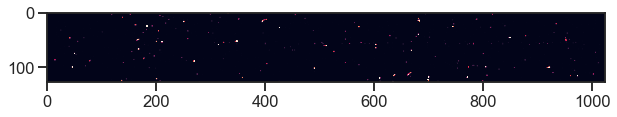

Frame 44


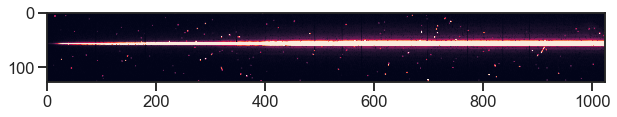

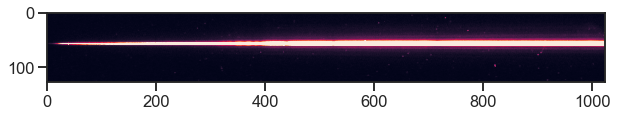

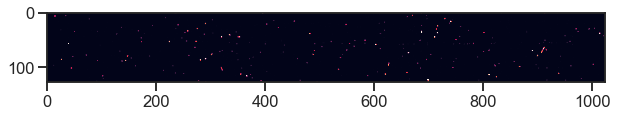

Frame 45


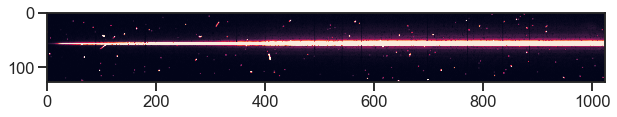

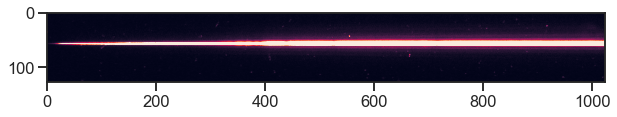

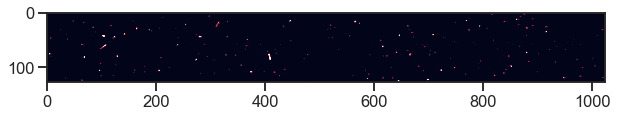

Frame 46


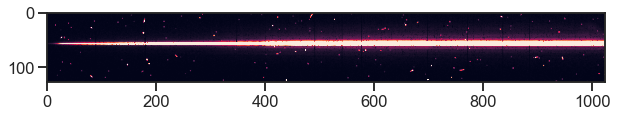

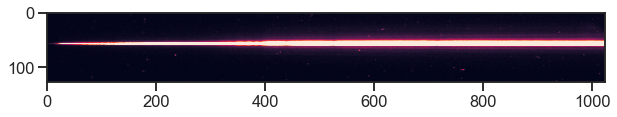

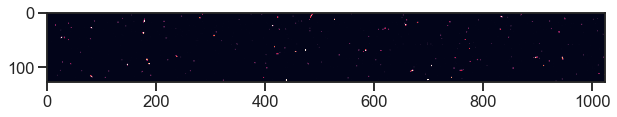

Frame 47


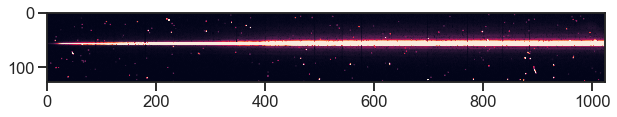

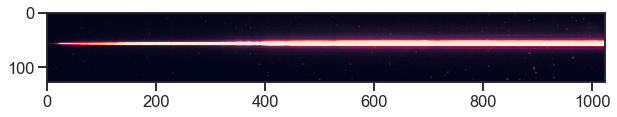

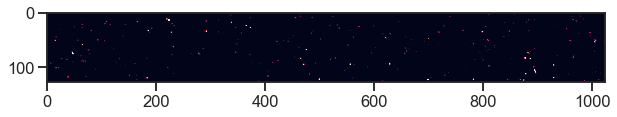

Frame 48


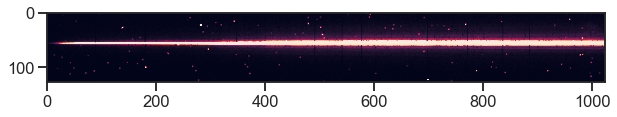

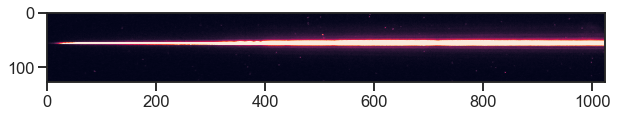

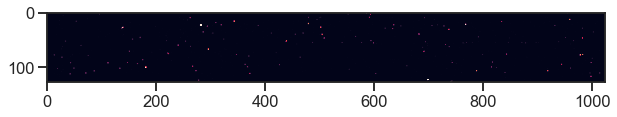

Frame 49


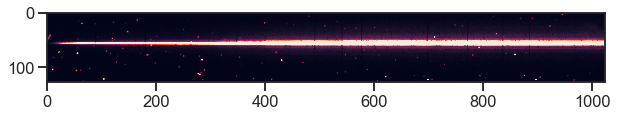

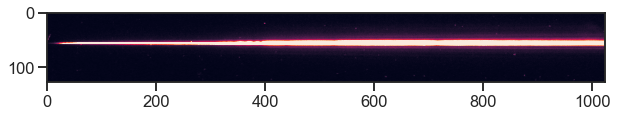

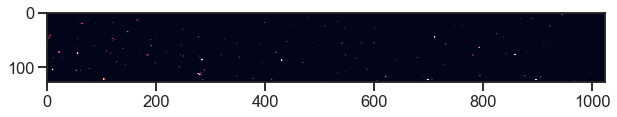

Frame 50


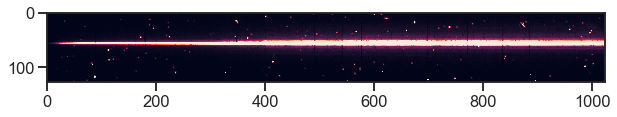

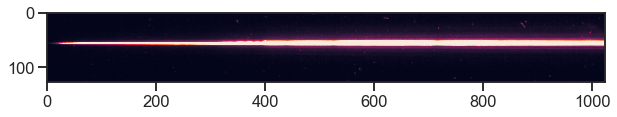

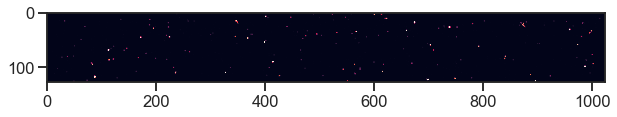

Frame 51


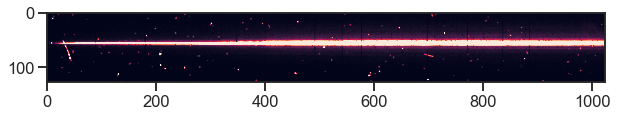

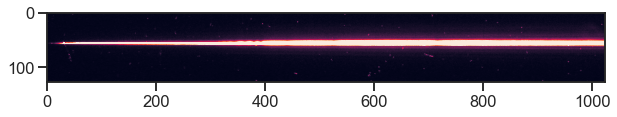

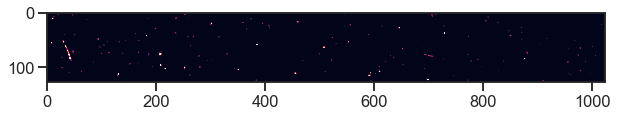

Frame 52


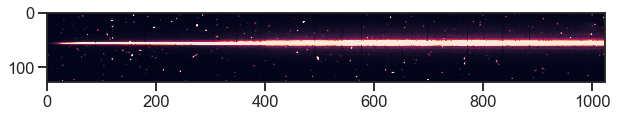

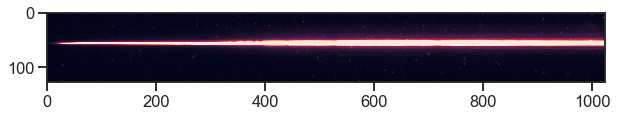

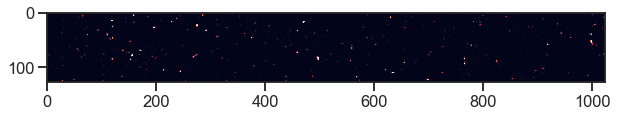

Frame 53


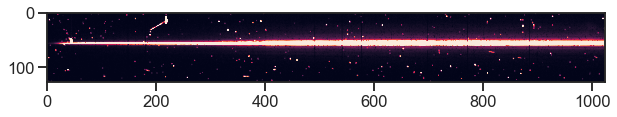

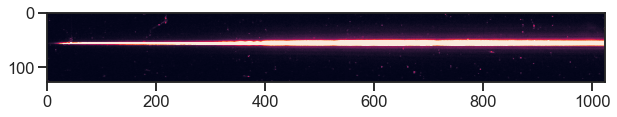

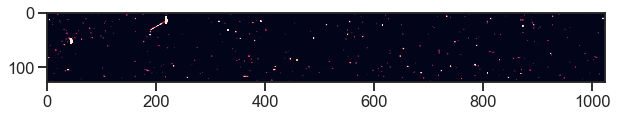

Frame 54


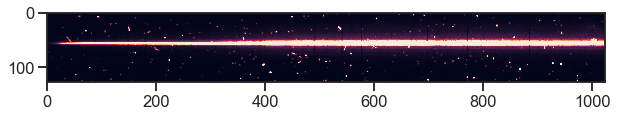

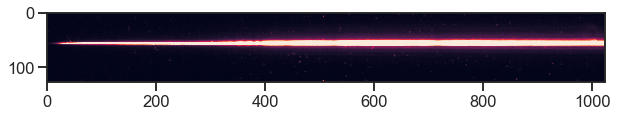

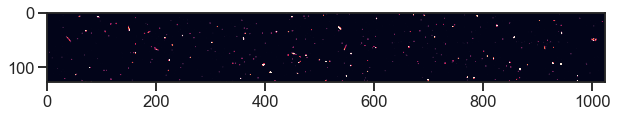

Frame 55


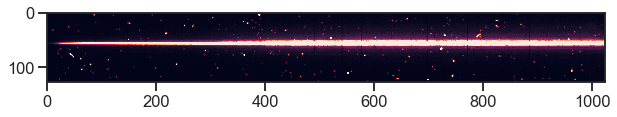

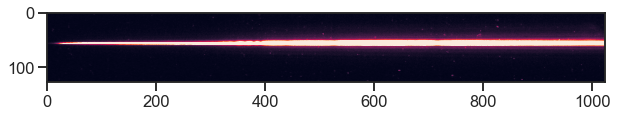

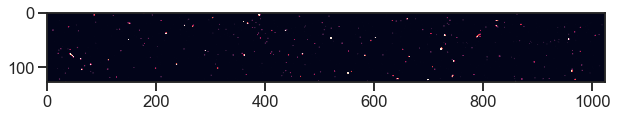

Frame 56


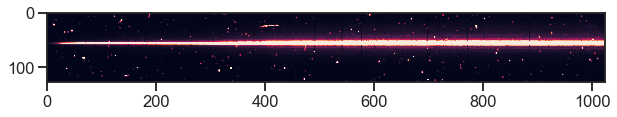

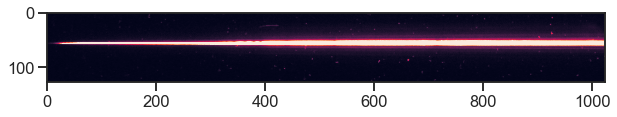

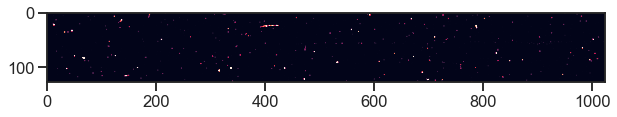

Frame 57


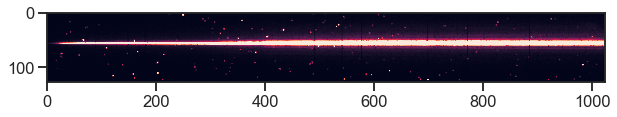

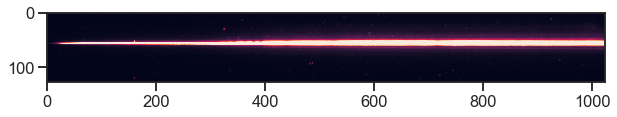

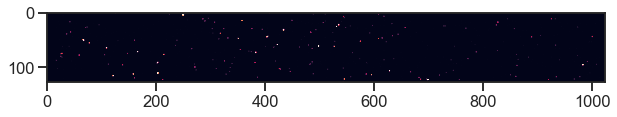

Frame 58


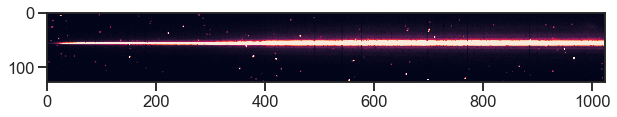

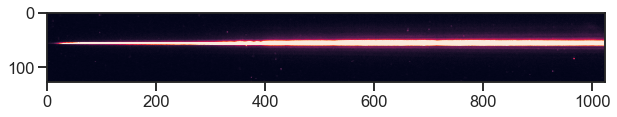

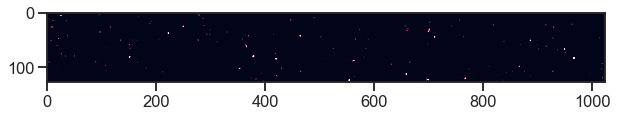

Frame 59


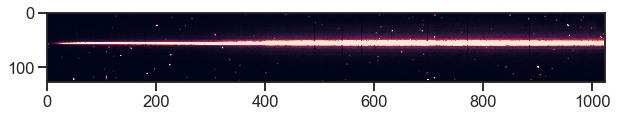

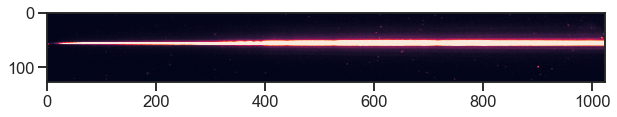

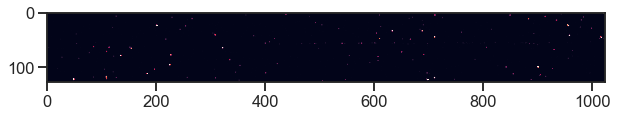

Frame 60


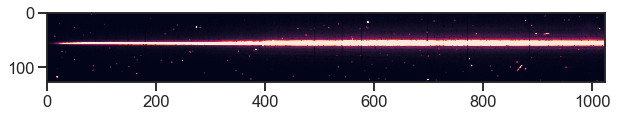

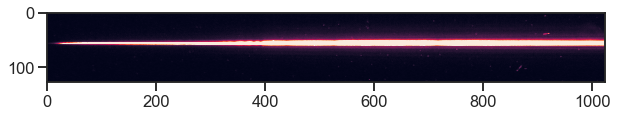

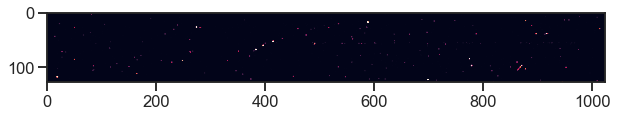

Frame 61


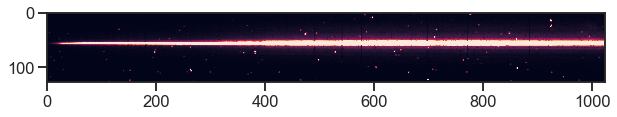

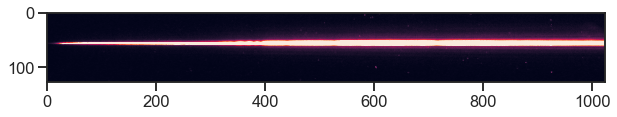

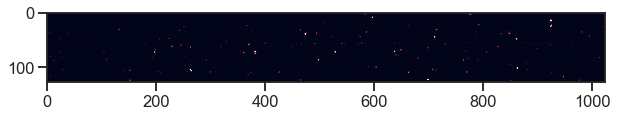

Frame 62


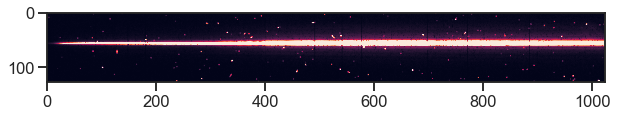

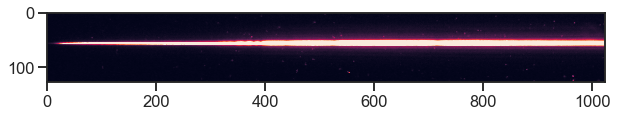

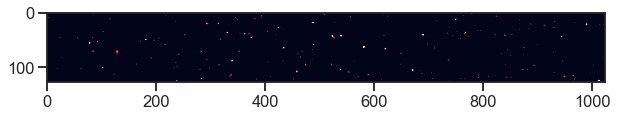

Frame 63


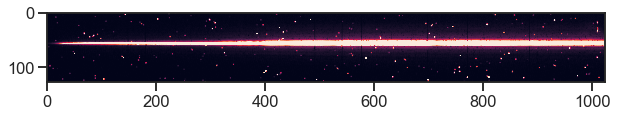

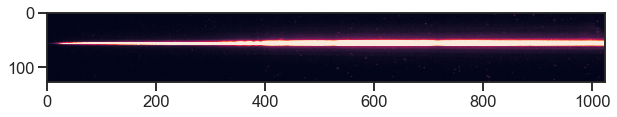

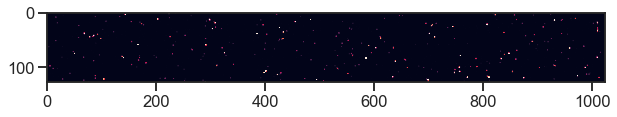

Frame 64


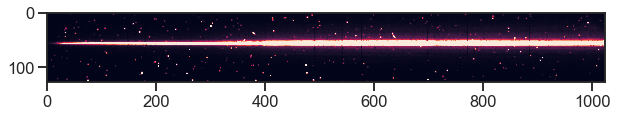

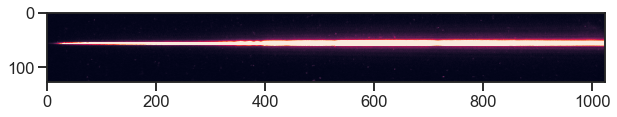

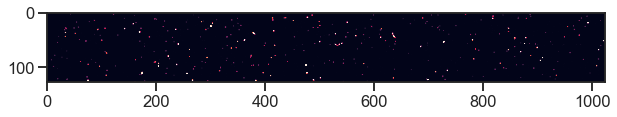

Frame 65


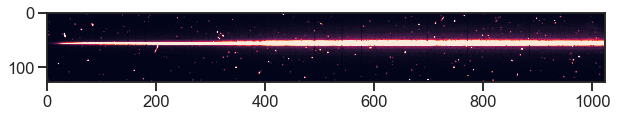

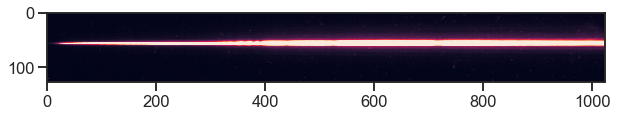

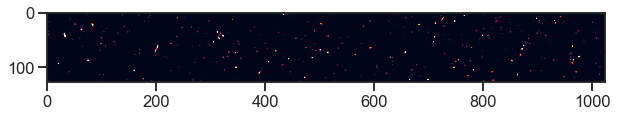

Frame 66


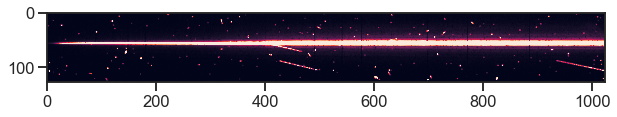

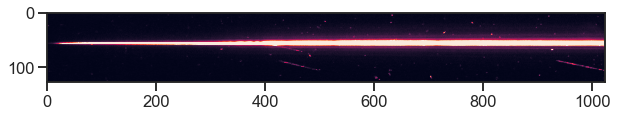

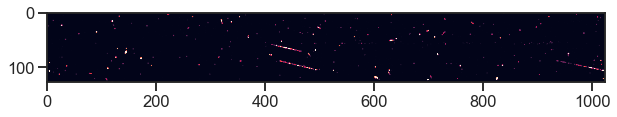

Frame 67


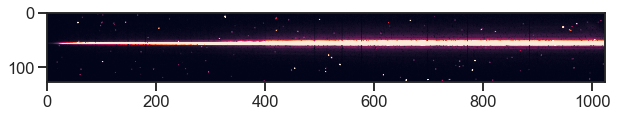

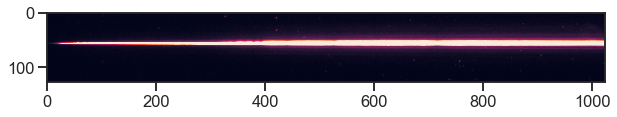

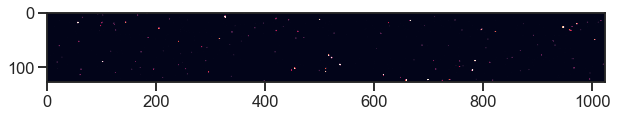

Frame 68


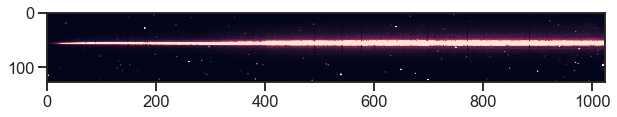

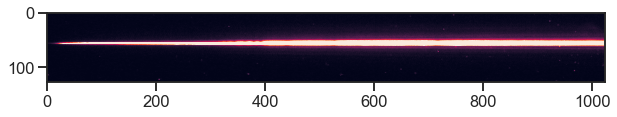

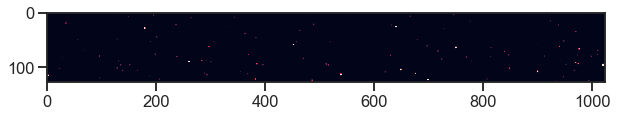

Frame 69


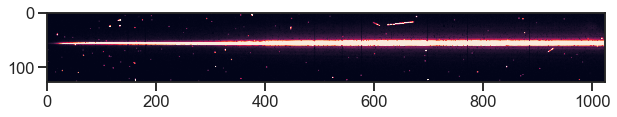

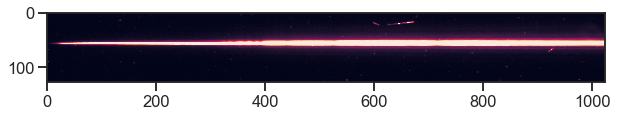

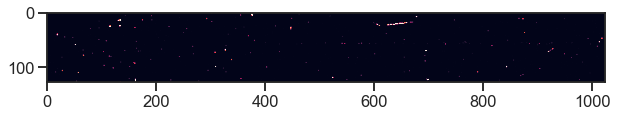

Frame 70


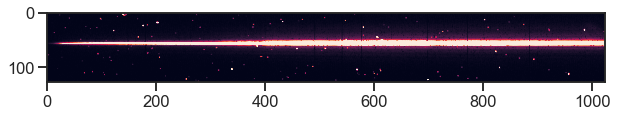

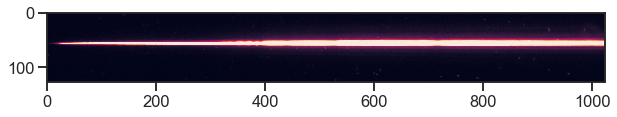

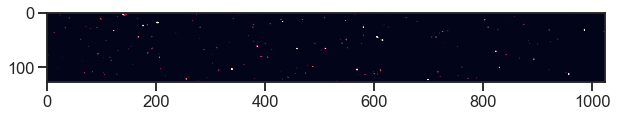

Frame 71


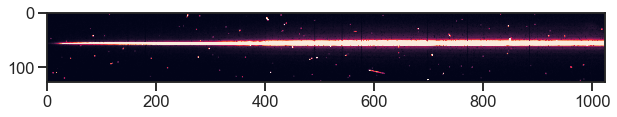

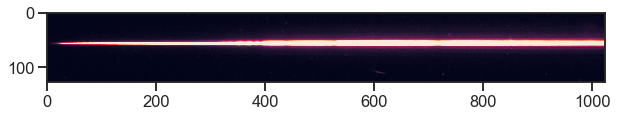

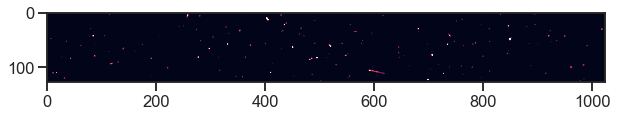

Frame 72


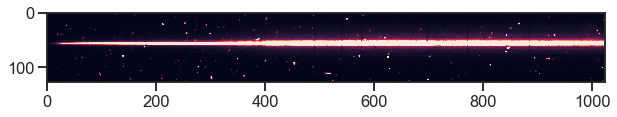

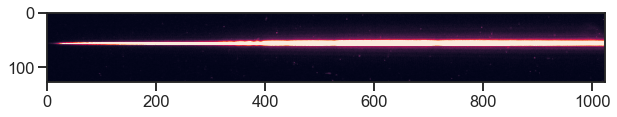

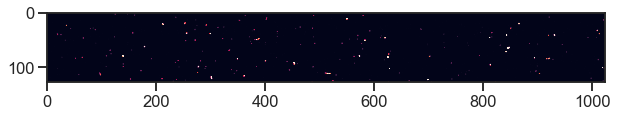

Frame 73


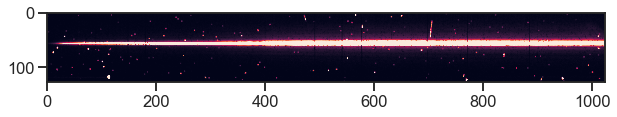

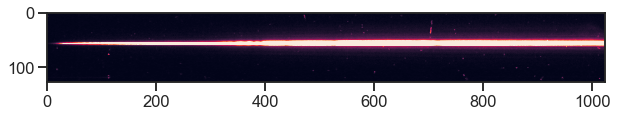

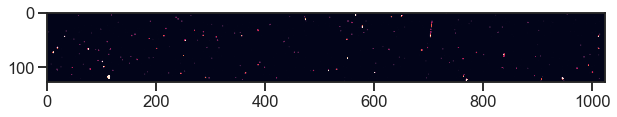

Frame 74


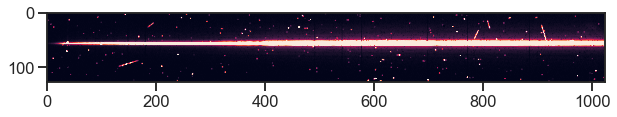

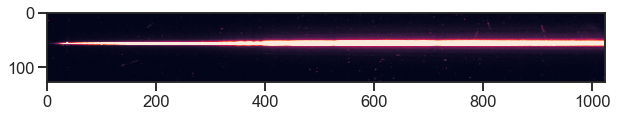

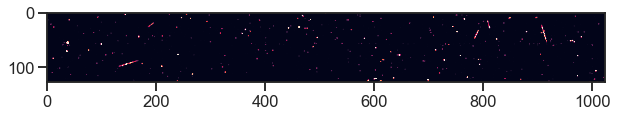

Frame 75


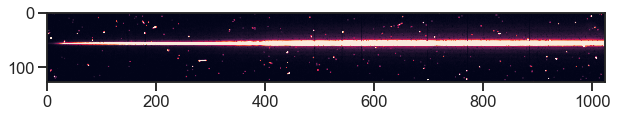

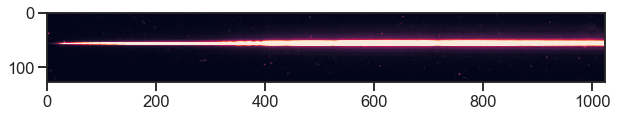

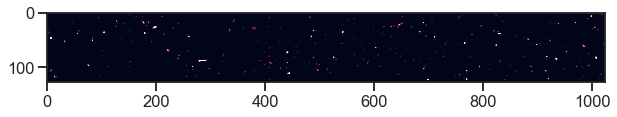

Frame 76


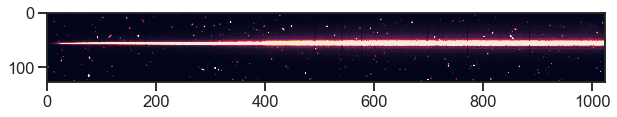

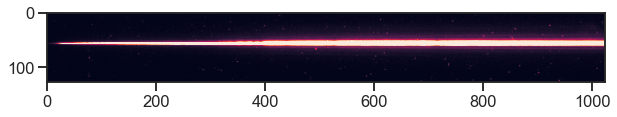

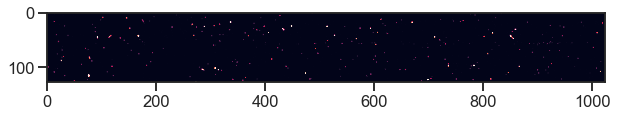

Frame 77


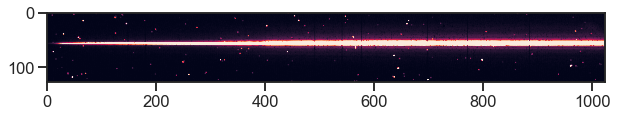

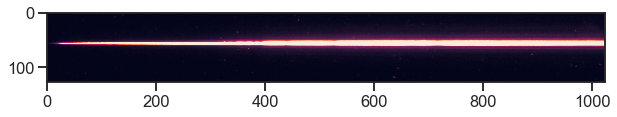

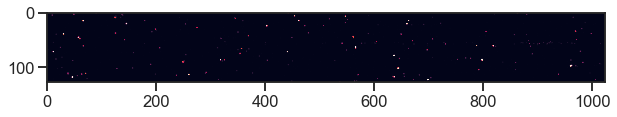

Frame 78


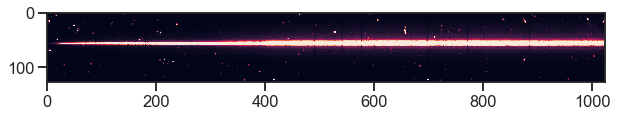

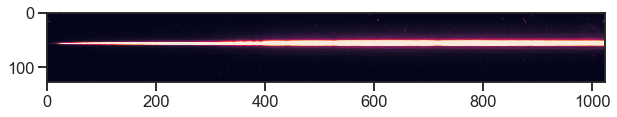

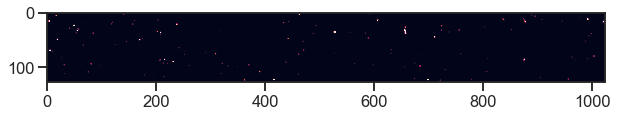

Frame 79


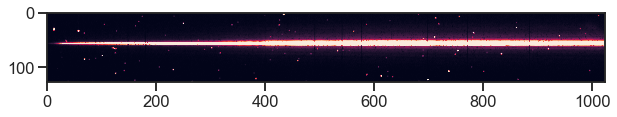

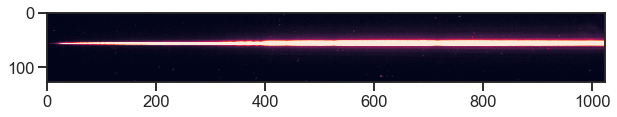

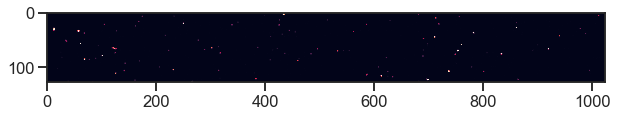

Frame 80


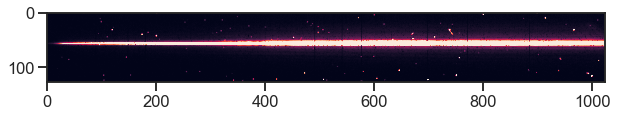

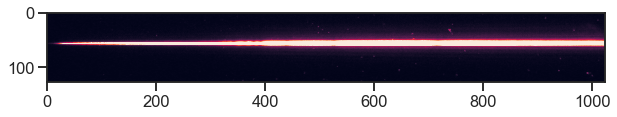

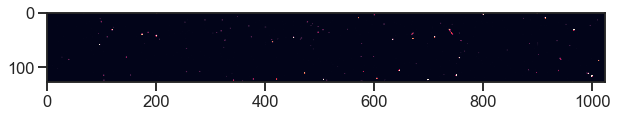

Frame 81


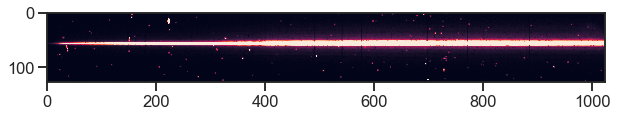

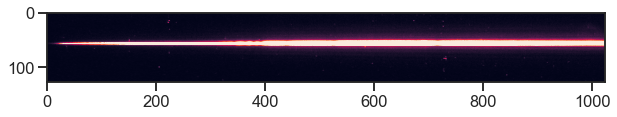

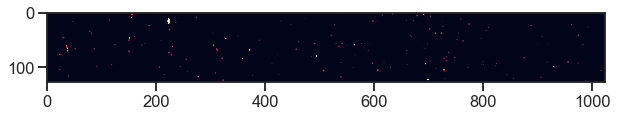

Frame 82


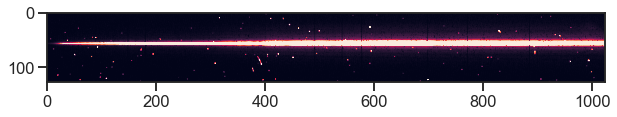

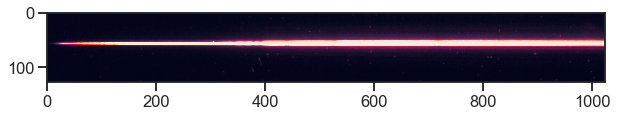

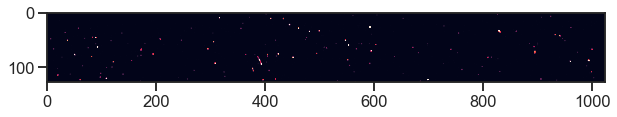

Frame 83


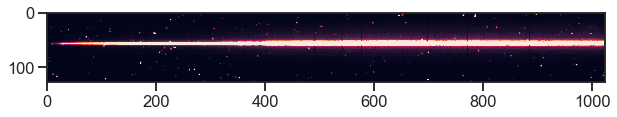

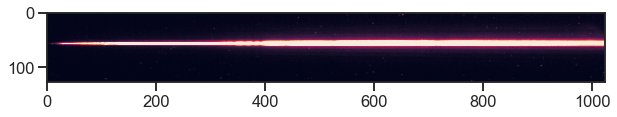

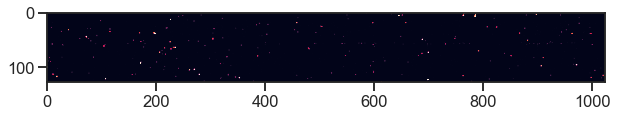

Frame 84


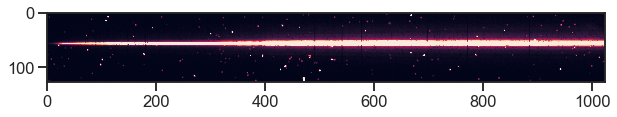

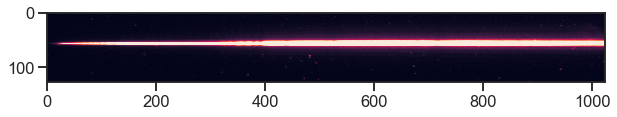

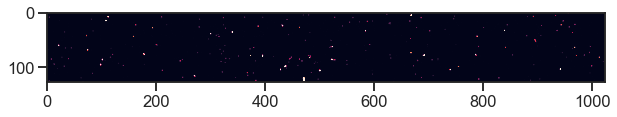

Frame 85


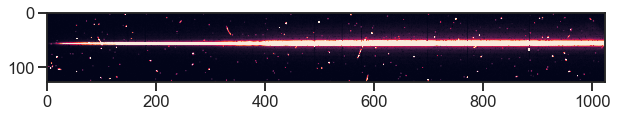

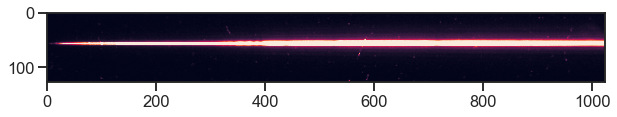

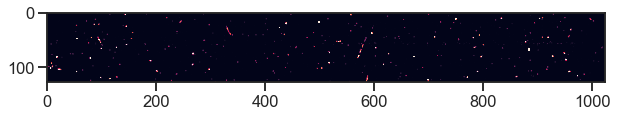

Frame 86


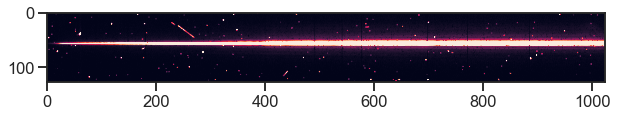

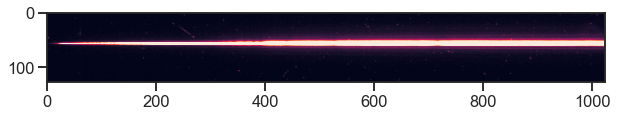

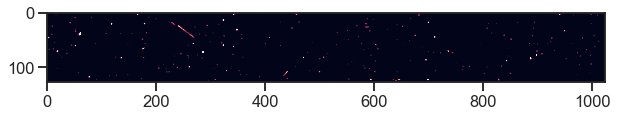

Frame 87


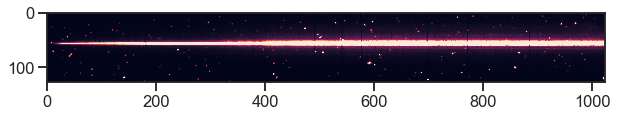

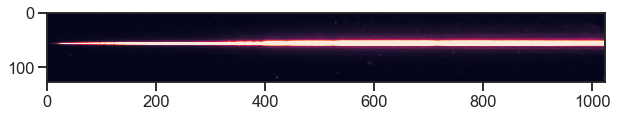

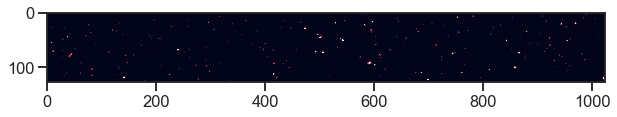

Frame 88


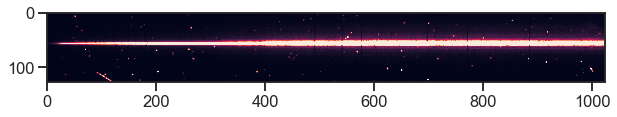

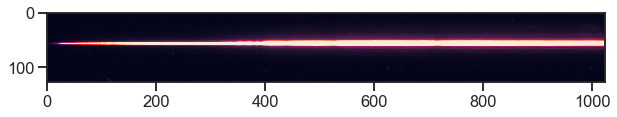

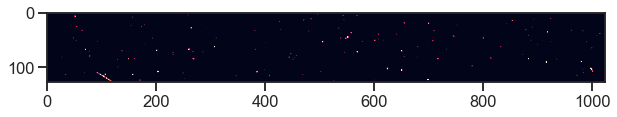

Frame 89


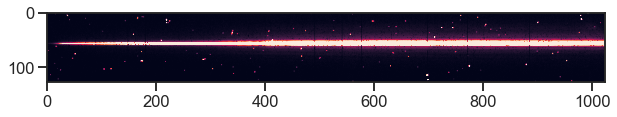

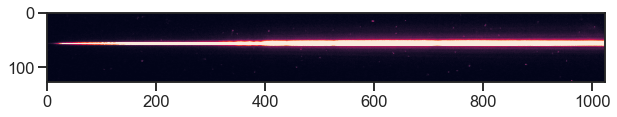

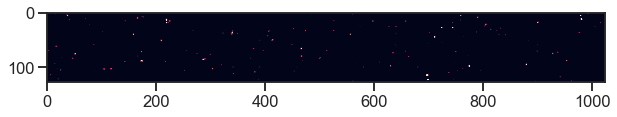

Frame 90


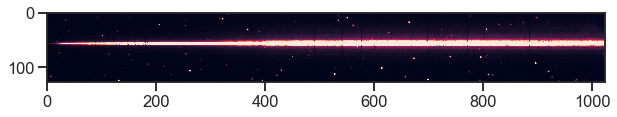

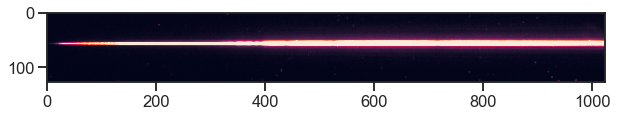

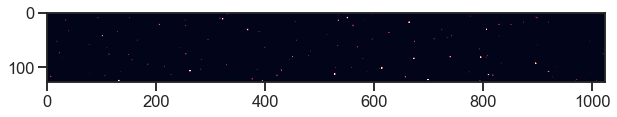

Frame 91


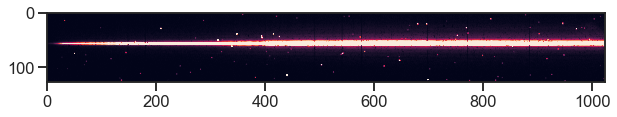

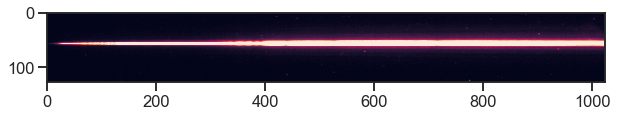

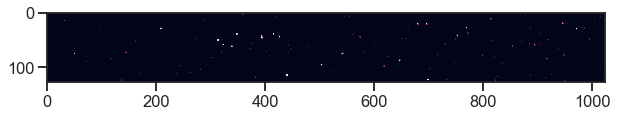

Frame 92


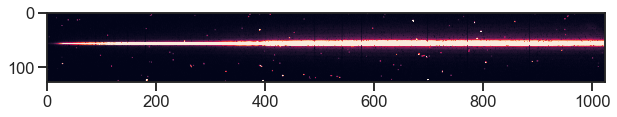

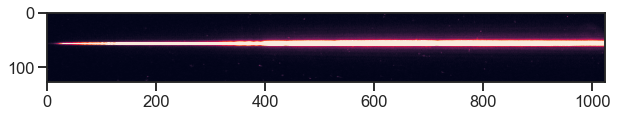

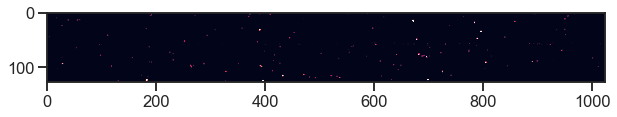

Frame 93


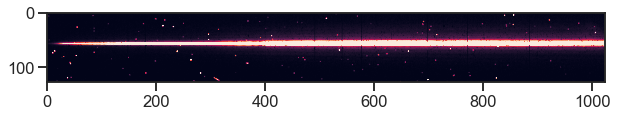

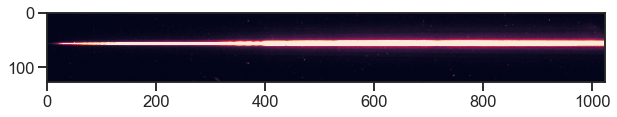

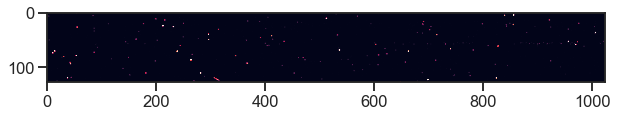

Frame 94


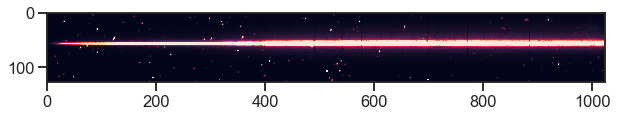

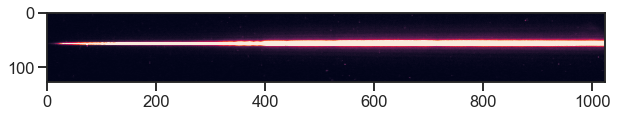

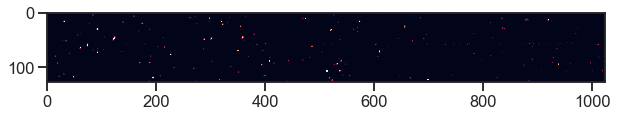

Frame 95


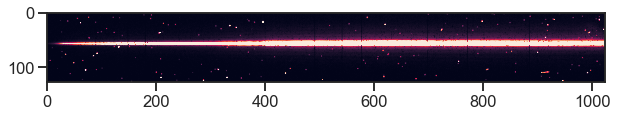

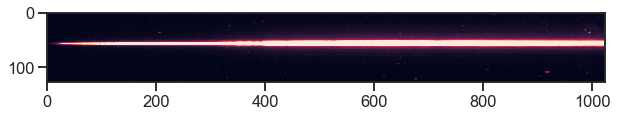

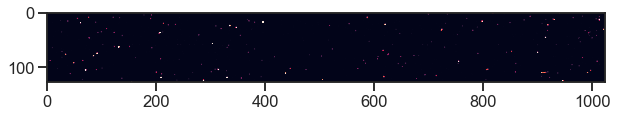

In [26]:
# and the 430 data
transit_430_cleaned_t = transit_430_cleaned + transit_430_2_cleaned

for i in range(len(transit_430_cleaned_t)):
    print("Frame", i)
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_430[0][i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(transit_430_cleaned_t[i])
    im.set_clim(0,200)
    plt.show()
    
    plt.figure(figsize = (10,7))
    im = plt.imshow(data_430[0][i]-transit_430_cleaned_t[i])
    im.set_clim(0,200)
    plt.show()
        

In [29]:
# save all of the cleaned images
name = "cleaned_data_wasp17_feb22"

if os.path.exists(name) != True:
    os.makedirs(name)
for i in range(len(transit_750_cleaned)):
    filename = "cleaned_750_1_" + str(i).zfill(3) + ".fits"
    fits.writeto(name + "/"+filename, transit_750_cleaned[i], data_750[1][i], overwrite=True)
    fits.append(name + "/"+filename, data_750[4][i])
    
for i in range(len(transit_430_cleaned)):
    filename = "cleaned_430_1_" + str(i).zfill(3) + ".fits"
    fits.writeto(name + "/"+filename, transit_430_cleaned[i], data_430[1][i], overwrite=True)
    fits.append(name + "/"+filename, data_430[4][i])
    
for i in range(len(transit_430_2_cleaned)):
    filename = "cleaned_430_2_" + str(i).zfill(3) + ".fits"
    fits.writeto(name + "/"+filename, transit_430_2_cleaned[i], data_430[1][48+i], overwrite=True)
    fits.append(name + "/"+filename, data_430[4][48+i])


In [30]:
# and then just write the jitter detrending vectors dictionary to a pickle file for later use
with open('jitter_750.pkl', 'wb') as handle:
    pickle.dump(data_750[2], handle, protocol=pickle.HIGHEST_PROTOCOL)

with open('jitter_430.pkl', 'wb') as handle:
    pickle.dump(data_430[2], handle, protocol=pickle.HIGHEST_PROTOCOL)

In [1]:
# now that we have the cleaned files, we don't need to run any of the above code a second time
# read those files in to have this as a new starting point
from STIS_pipeline_functions import *

name = "cleaned_data_wasp17_feb22"

cleaned_data_430_1 = sorted(glob.glob(name + "/cleaned_430_1*"))
transit_430_cleaned = []
headers_430 = []
errs_430 = []
for i in cleaned_data_430_1:
    c_data, hdr = fits.getdata(i, ext = 0, header = True)
    transit_430_cleaned.append(c_data)
    headers_430.append(hdr)
    e_data = fits.getdata(i, ext = 1)
    errs_430.append(e_data)
    
cleaned_data_430_2 = sorted(glob.glob(name + "/cleaned_430_2*"))
transit_430_2_cleaned = []
headers_430_2 = []
errs_430_2 = []
for i in cleaned_data_430_2:
    c_data, hdr = fits.getdata(i, ext = 0, header = True)
    transit_430_2_cleaned.append(c_data)
    headers_430_2.append(hdr)
    e_data = fits.getdata(i, ext = 1)
    errs_430_2.append(e_data)

with open('jitter_430.pkl', 'rb') as handle:
    jit_430 = pickle.load(handle)

/Users/natalieallen/opt/anaconda3/lib/python3.8/site-packages/autograd/numpy/numpy_wrapper.py:20: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  int_types = {_np.int, _np.int8, _np.int16, _np.int32, _np.int64, _np.integer}


In [2]:
cleaned_data_750 = sorted(glob.glob(name + "/cleaned_750*"))
transit_750_cleaned = []
headers_750 = []
errs_750 = []
for i in cleaned_data_750:
    c_data, hdr = fits.getdata(i, ext = 0, header = True)
    transit_750_cleaned.append(c_data)
    headers_750.append(hdr)
    e_data = fits.getdata(i, ext = 1)
    errs_750.append(e_data)

with open('jitter_750.pkl', 'rb') as handle:
    jit_750 = pickle.load(handle)

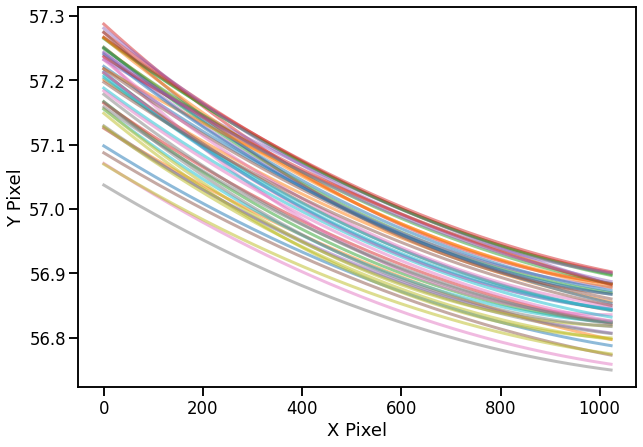

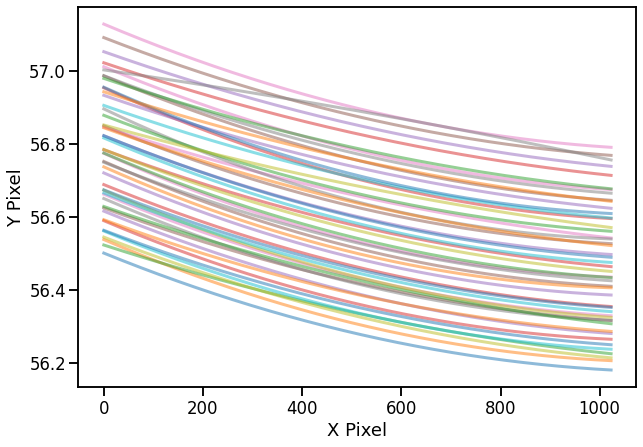

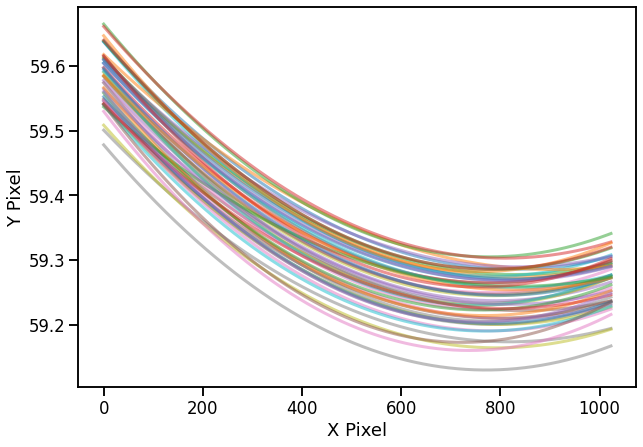

In [3]:
# now to retrace the cleaned data
trace_430_list = []
plt.figure(figsize = (10,7))
for i in transit_430_cleaned:
    trace = trace_spectrum(i, 200,1000,60)
    trace_430_list.append(trace)

trace_430_coeffs = []
trace_430_fit = []
for j in trace_430_list:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    plt.plot(np.arange(len(transit_430_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_cleaned[0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(transit_430_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_cleaned[0][0])),coeffs1)]
    trace_430_fit.append(trace)
    trace_430_coeffs.append(coeffs1)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

trace_430_2_list = []
plt.figure(figsize = (10,7))
for i in transit_430_2_cleaned:
    trace = trace_spectrum(i, 200,1000,60)
    trace_430_2_list.append(trace)

trace_430_2_coeffs = []
trace_430_2_fit = []
for j in trace_430_2_list:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    plt.plot(np.arange(len(transit_430_2_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_2_cleaned[0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(transit_430_2_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_430_2_cleaned[0][0])),coeffs1)]
    trace_430_2_fit.append(trace)
    trace_430_2_coeffs.append(coeffs1)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()

trace_750_list = []
plt.figure(figsize = (10,7))
for i in transit_750_cleaned:
    trace = trace_spectrum(i, 200,1000,60)
    trace_750_list.append(trace)

trace_750_coeffs = []
trace_750_fit = []
for j in trace_750_list:
    coeffs1 = chebyshev.chebfit(j[0], j[1], deg=2)
    plt.plot(np.arange(len(transit_750_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_750_cleaned[0][0])),coeffs1),lw=3, alpha = 0.5)
    trace = [np.arange(len(transit_750_cleaned[0][0])),chebyshev.chebval(np.arange(len(transit_750_cleaned[0][0])),coeffs1)]
    trace_750_fit.append(trace)
    trace_750_coeffs.append(coeffs1)
plt.ylabel("Y Pixel")
plt.xlabel("X Pixel")
plt.show()


In [4]:
# now for the spectral extraction - I use optimal since I don't do the spline cleaning, and I feed in the ron and 
# gain values from the header
spectra_430 = []
for i in range(len(transit_430_cleaned)):
    spec = spectral_extraction(transit_430_cleaned[i], trace_430_fit[i], method = "optimal", gain = 4.0159998, ron = 8.2327986, polynomial_order = 3, nsigma = 12)
    spectra_430.append(spec)

In [5]:
spectra_430_2 = []
for i in range(len(transit_430_2_cleaned)):
    spec = spectral_extraction(transit_430_2_cleaned[i], trace_430_2_fit[i], method = "optimal", gain = 4.0159998, ron = 8.2327986, polynomial_order = 3, nsigma = 12)
    spectra_430_2.append(spec)

In [6]:
spectra_750 = []
for i in range(len(transit_750_cleaned)):
    spec = spectral_extraction(transit_750_cleaned[i], trace_750_fit[i], method = "optimal", gain = 4.0159998, ron = 8.2327986, polynomial_order = 3, nsigma = 12)
    spectra_750.append(spec)

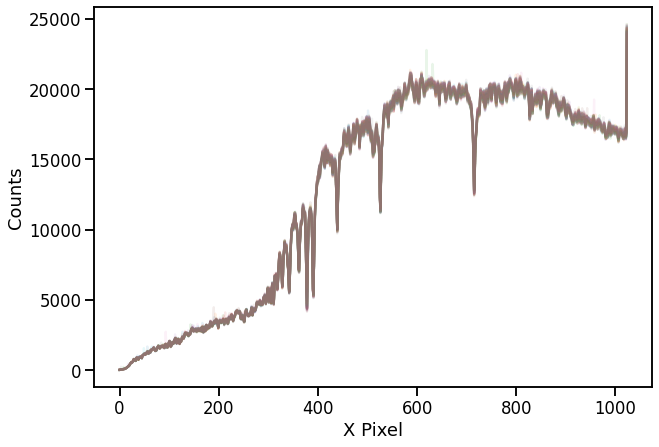

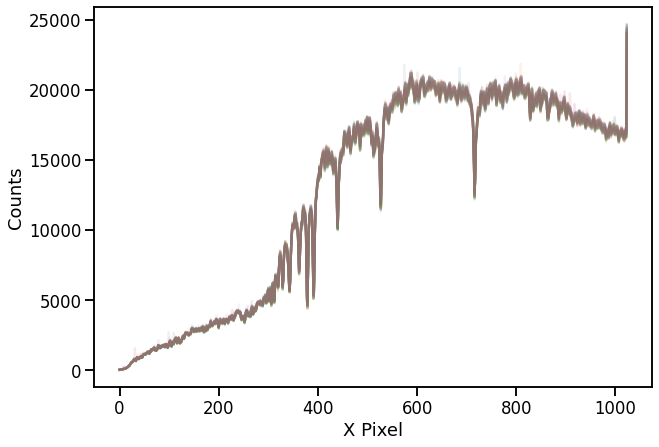

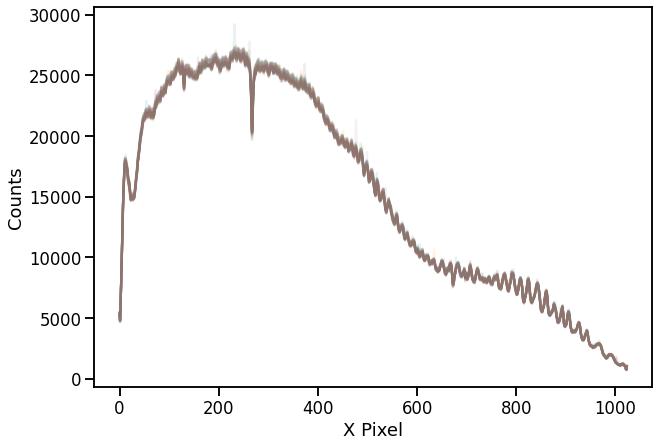

In [7]:
%matplotlib inline
# plot all of the spectra on top of each other
plt.figure(figsize = (10,7))
for i in spectra_430:
    plt.plot(i[1], alpha = 0.1)
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_430_2:
    plt.plot(i[1], alpha = 0.1)
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_750:
    plt.plot(i[1], alpha = 0.1)
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.show()

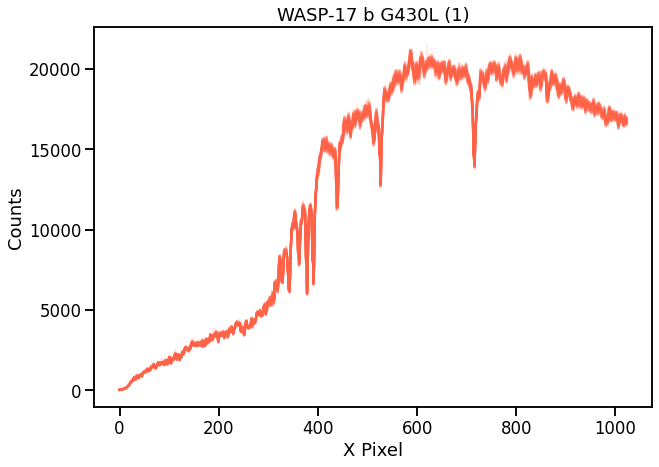

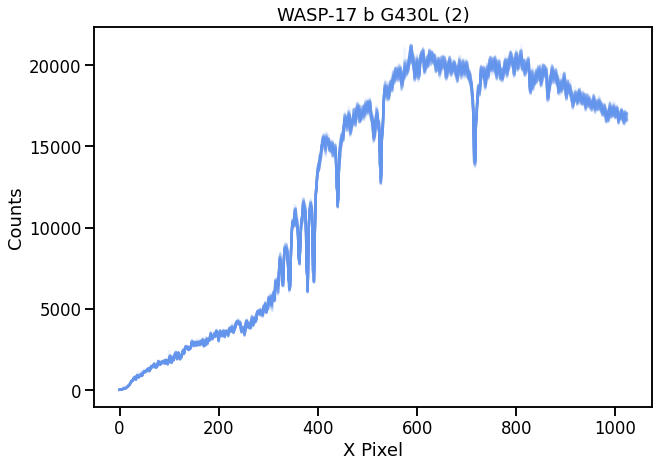

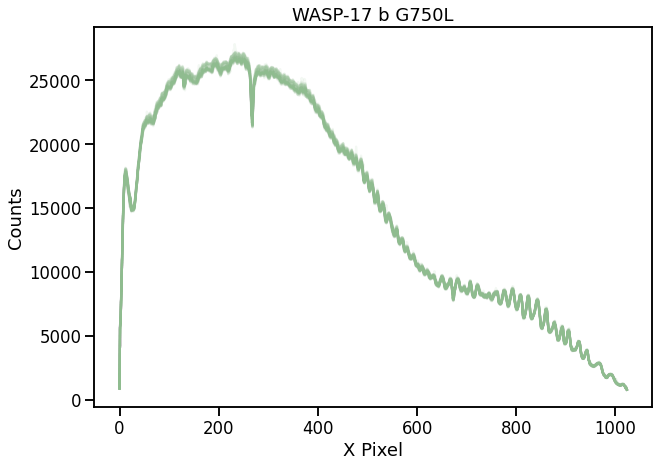

In [8]:
# hm, there's maybe a few outliers, so let's just try to get rid of some of those using a basic median filter function
spectra_430 = spectrum_outliers(spectra_430)
spectra_430_2 = spectrum_outliers(spectra_430_2)
spectra_750 = spectrum_outliers(spectra_750)

plt.figure(figsize = (10,7))
for i in spectra_430:
    plt.plot(i[1], alpha = 0.1, color = "tomato")
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.title("WASP-17 b G430L (1)")
#plt.savefig("w17b_g430l_extspec1.png", dpi = 300, facecolor = "white")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_430_2:
    plt.plot(i[1], alpha = 0.1, color = "cornflowerblue")
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.title("WASP-17 b G430L (2)")
#plt.savefig("w17b_g430l_extspec2.png", dpi = 300, facecolor = "white")
plt.show()

plt.figure(figsize = (10,7))
for i in spectra_750:
    plt.plot(i[1], alpha = 0.1, color = "darkseagreen")
plt.ylabel("Counts")
plt.xlabel("X Pixel")
plt.title("WASP-17 b G750L")
#plt.savefig("w17b_g750l_extspec.png", dpi = 300, facecolor = "white")
plt.show()

In [9]:
# sum up each of the spectra for the white light curve
lc_430 = []
lc_err_430 = []
for i in spectra_430:
    point = np.nansum(i[1])
    # optimal extraction outputs inverse variance, so np.sqrt(np.nansum((1/np.sqrt(i[2]))**2)) 
    # is the error on each point
    err = np.sqrt(np.nansum((1/np.sqrt(i[2]))**2))
    lc_430.append(point)
    lc_err_430.append(err)
    
lc_430_2 = []
lc_err_430_2 = []
for i in spectra_430_2:
    point = np.nansum(i[1])
    err = np.sqrt(np.nansum((1/np.sqrt(i[2]))**2))
    lc_430_2.append(point)
    lc_err_430_2.append(err)
    
lc_750 = []
lc_err_750 = []
for i in spectra_750:
    point = np.nansum(i[1])
    err = np.sqrt(np.nansum((1/np.sqrt(i[2]))**2))
    lc_750.append(point)
    lc_err_750.append(err)

In [10]:
# now to deal with the timestamps. HST header times come in JDUTC, we want BJD-TBD 
times_430 = times_to_bjd(headers_430, starname = "WASP-17")
times_start_430 = times_430[0][0]
times_end_430 = times_430[0][1]

times_430_2 = times_to_bjd(headers_430_2, starname = "WASP-17")
times_start_430_2 = times_430_2[0][0]
times_end_430_2 = times_430_2[0][1]

times_750 = times_to_bjd(headers_750, starname = "WASP-17")
times_start_750 = times_750[0][0]
times_end_750 = times_750[0][1]

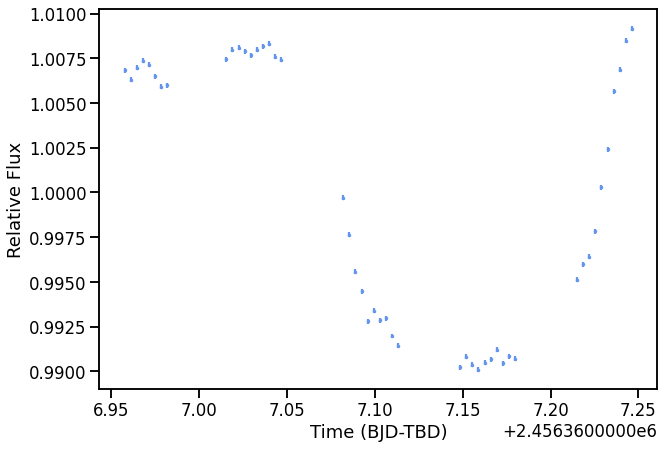

In [11]:
# should now be able to plot our raw white light curve - looks pretty good!
plt.figure(figsize = (10,7))
plt.errorbar(times_start_430, lc_430/np.nanmedian(lc_430), yerr = lc_err_430/np.nanmedian(lc_430), fmt = ".", color = "cornflowerblue", label = "var")
plt.xlabel("Time (BJD-TBD)")
plt.ylabel("Relative Flux")
#plt.ylim(0.95, 1.01)
plt.show()

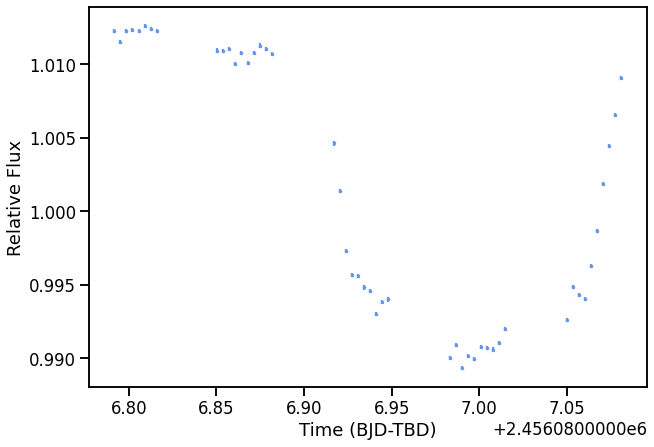

In [12]:
plt.figure(figsize = (10,7))
plt.errorbar(times_start_430_2, lc_430_2/np.nanmedian(lc_430_2), yerr = lc_err_430_2/np.nanmedian(lc_430_2), fmt = ".", color = "cornflowerblue", label = "var")
plt.xlabel("Time (BJD-TBD)")
plt.ylabel("Relative Flux")
#plt.ylim(0.95, 1.01)
plt.show()

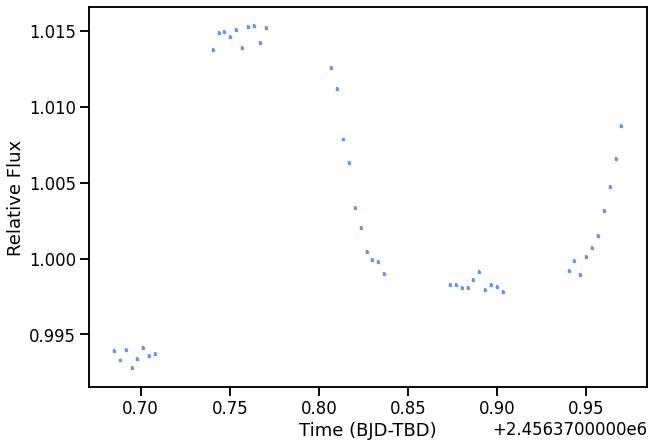

In [13]:
# oof that first orbit
plt.figure(figsize = (10,7))
plt.errorbar(times_start_750, lc_750/np.nanmedian(lc_750), yerr = lc_err_750/np.nanmedian(lc_750), fmt = ".", color = "cornflowerblue", label = "var")
plt.xlabel("Time (BJD-TBD)")
plt.ylabel("Relative Flux")
#plt.ylim(0.95, 1.01)
plt.show()

In [14]:
# calculate trace polynomial movement - another detrending vector
template_430 = np.nanmedian(trace_430_coeffs, axis = 0)
movement_430 = []
movement_coeff1_430 = []
movement_coeff2_430 = []
for i in trace_430_coeffs:
    #plt.plot(template_430-i)
    #movement_430.append(np.nanmedian(template_430-i[1]))
    movement_430.append((template_430-i)[0])
    movement_coeff1_430.append((template_430-i)[1])
    movement_coeff2_430.append((template_430-i)[2])
    
#jit_430["Y"] = movement_430

template_430_2 = np.nanmedian(trace_430_2_coeffs, axis = 0)
movement_430_2 = []
movement_coeff1_430_2 = []
movement_coeff2_430_2 = []
for i in trace_430_2_coeffs:
    #plt.plot(template_430-i)
    #movement_430.append(np.nanmedian(template_430-i[1]))
    movement_430_2.append((template_430-i)[0])
    movement_coeff1_430_2.append((template_430-i)[1])
    movement_coeff2_430_2.append((template_430-i)[2])

#jit_430["Y"] = movement_430 + movement_430_2
jit_430["T_move"] = movement_430 + movement_430_2
jit_430["T_coeff1"] = movement_coeff1_430 + movement_coeff1_430_2
jit_430["T_coeff2"] = movement_coeff2_430 + movement_coeff2_430_2

In [15]:
template_750 = np.nanmedian(trace_750_coeffs, axis = 0)
movement_750 = []
movement_coeff1_750 = []
movement_coeff2_750 = []
for i in trace_750_coeffs:
    #plt.plot(template_430-i)
    #movement_430.append(np.nanmedian(template_430-i[1]))
    movement_750.append((template_750-i)[0])
    movement_coeff1_750.append((template_750-i)[1])
    movement_coeff2_750.append((template_750-i)[2])
#jit_750["Y"] = movement_750
jit_750["T_move"] = movement_750
jit_750["T_coeff1"] = movement_coeff1_750
jit_750["T_coeff2"] = movement_coeff2_750

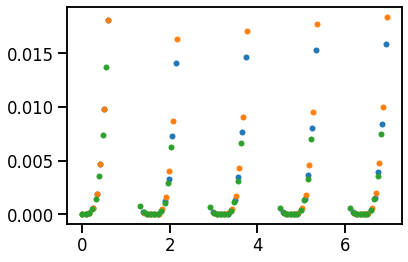

In [16]:
# last detrending vector: HST orbital phase

HST_period = 95.42/(60. * 24.) # HST period in days
#visit['orbital phase'] = juliet.utils.get_phases(visit['times'], HST_period, visit['times'][0])
phase_430_1 = juliet.utils.get_phases(times_start_430, HST_period, times_start_430[0])**4
phase_430_2 = juliet.utils.get_phases(times_start_430_2, HST_period, times_start_430_2[0])**4

jit_430["phase^4"] = list(phase_430_1) + list(phase_430_2)

jit_750["phase^4"] = juliet.utils.get_phases(times_start_750, HST_period, times_start_750[0])**4

# looks about right
plt.plot((times_start_430 - times_start_430[0])*24, phase_430_1, "o")
plt.plot((times_start_430_2 - times_start_430_2[0])*24, phase_430_2, "o")
plt.plot((times_start_750 - times_start_750[0])*24, jit_750["phase^4"], "o")

In [17]:
# before fitting, we just need to normalize our detrending vectors into standard deviation
# these are the detrending vectors to use
jit_use = ["V2_roll", "V3_roll", "Latitude", "Longitude", "RA", "DEC", "T_move", "T_coeff1", "T_coeff2", "phase^4"]

norm_jit_750 = {}
for i in jit_use:
    norm = (jit_750[i]-np.nanmean(jit_750[i]))
    norm_jit_750[i] = norm/np.std(norm)

In [18]:
jit_use = ["V2_roll", "V3_roll", "Latitude", "Longitude", "RA", "DEC", "T_move", "T_coeff1", "T_coeff2", "phase^4"]
norm_jit_430 = {}
for i in jit_use:
    norm = (jit_430[i][:48]-np.nanmean(jit_430[i][:48]))
    norm_jit_430[i] = norm/np.std(norm)
    
norm_jit_430_2 = {}
for i in jit_use:
    norm = (jit_430[i][48:]-np.nanmean(jit_430[i][48:]))
    norm_jit_430_2[i] = norm/np.std(norm)

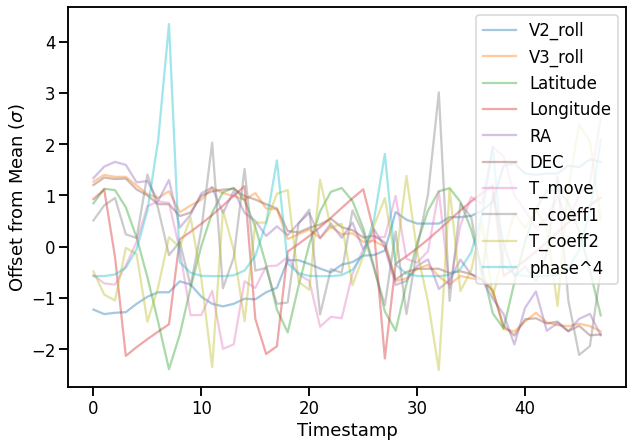

In [19]:
# check them out 
plt.figure(figsize = (10,7))
for i in norm_jit_750:
    plt.plot(norm_jit_750[i], alpha = 0.4, label = str(i))
plt.xlabel("Timestamp")
plt.ylabel(r"Offset from Mean ($\sigma$)")
plt.legend()
plt.show()

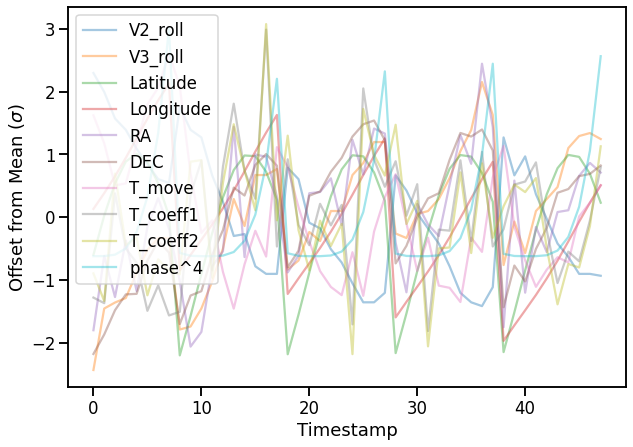

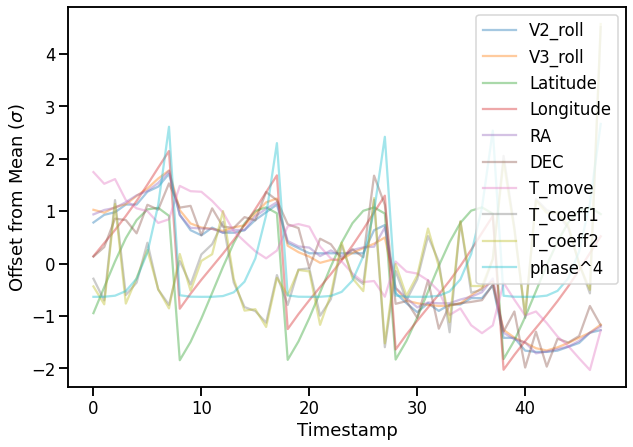

In [20]:
plt.figure(figsize = (10,7))
for i in norm_jit_430:
    plt.plot(norm_jit_430[i], alpha = 0.4, label = str(i))
plt.xlabel("Timestamp")
plt.ylabel(r"Offset from Mean ($\sigma$)")
plt.legend()
plt.show()

plt.figure(figsize = (10,7))
for i in norm_jit_430_2:
    plt.plot(norm_jit_430_2[i], alpha = 0.4, label = str(i))
plt.xlabel("Timestamp")
plt.ylabel(r"Offset from Mean ($\sigma$)")
plt.legend()
plt.show()

In [21]:
# take out that bad first orbit for the 750 data
times_start_750_less = times_start_750[8:]
lc_750_less = lc_750[8:]
lc_err_750_less = lc_err_750[8:]
spectra_750_less = spectra_750[8:]
norm_jit_750_less = {}
jit_names = list(norm_jit_750.keys())
for i in range(len(norm_jit_750)):
    norm_jit_750_less[jit_names[i]] = norm_jit_750[jit_names[i]][8:]

In [22]:
# now we need to run PCA on these detrending vectors
# do the PCA
vectors = [norm_jit_430[i] for i in list(norm_jit_430.keys())]
eigenvectors,eigenvalues,PC = classic_PCA(vectors)

norm_pc_430 = {}
j = 0
for i in PC:
    norm = (i-np.nanmean(i))
    name = "PC" + str(j)
    j = j+1
    norm_pc_430[name] = norm/np.std(norm)
    
    
vectors2 = [norm_jit_430_2[i] for i in list(norm_jit_430_2.keys())]
eigenvectors,eigenvalues,PC2 = classic_PCA(vectors2)

norm_pc_430_2 = {}
j = 0
for i in PC2:
    norm = (i-np.nanmean(i))
    name = "PC" + str(j)
    j = j+1
    norm_pc_430_2[name] = norm/np.std(norm)
    
vectors_750 = [norm_jit_750_less[i] for i in list(norm_jit_750_less.keys())]
eigenvectors,eigenvalues,PC = classic_PCA(vectors_750)

norm_pc_750 = {}
j = 0
for i in PC:
    norm = (i-np.nanmean(i))
    name = "PC" + str(j)
    j = j+1
    norm_pc_750[name] = norm/np.std(norm)
    

In [23]:
# and get the important PC lists (2 and 5, according to our testing)
    
norm_pc_use2_430 = {}
names = list(norm_pc_430.keys())
for i in range(2):
    name = "PC" + str(i+1)
    norm_pc_use2_430[name] = norm_pc_430[names[i]]
    
norm_pc_use2_430_2 = {}
names = list(norm_pc_430_2.keys())
for i in range(2):
    name = "PC" + str(i+1)
    norm_pc_use2_430_2[name] = norm_pc_430_2[names[i]]
    
norm_pc_use5_430 = {}
names = list(norm_pc_430.keys())
for i in range(5):
    name = "PC" + str(i+1)
    norm_pc_use5_430[name] = norm_pc_430[names[i]]
    
norm_pc_use5_430_2 = {}
names = list(norm_pc_430_2.keys())
for i in range(5):
    name = "PC" + str(i+1)
    norm_pc_use5_430_2[name] = norm_pc_430_2[names[i]]
    
norm_pc_use2_750 = {}
names = list(norm_pc_750.keys())
for i in range(2):
    name = "PC" + str(i+1)
    norm_pc_use2_750[name] = norm_pc_750[names[i]]
    
norm_pc_use5_750 = {}
names = list(norm_pc_750.keys())
for i in range(5):
    name = "PC" + str(i+1)
    norm_pc_use5_750[name] = norm_pc_750[names[i]]

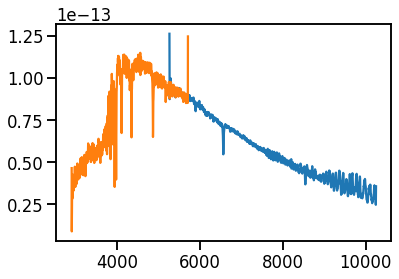

In [24]:
# next, we get the wavelength solution 
wl_sol_750 = fits.getdata("wasp-17/HST/G750L/obri19010/obri19010_x1d.fits", ext = 1)
for i, order_750 in enumerate(wl_sol_750):
    plt.plot(order_750["WAVELENGTH"], order_750["FLUX"])
    
wl_sol_430 = fits.getdata("wasp-17/HST/G430L/obri05010/obri05010_x1d.fits", ext = 1)
for i, order_430 in enumerate(wl_sol_430):
    plt.plot(order_430["WAVELENGTH"], order_430["FLUX"])

In [25]:
# we're going to fix limb darkening for now
# change the path here to your exotic-ld_data

from exotic_ld import StellarLimbDarkening

sld = StellarLimbDarkening(
            M_H=-0.25, Teff=6550, logg=4.2, ld_model='1D',
            ld_data_path="/Users/natalieallen/Documents/Grad/Sing Research/exotic-ld_data")

c1_430, c2_430 = sld.compute_quadratic_ld_coeffs(
            wavelength_range=np.array([order_430["WAVELENGTH"][0], order_430["WAVELENGTH"][-1]]),
            mode='HST_STIS_G430L')

c1_750, c2_750 = sld.compute_quadratic_ld_coeffs(
            wavelength_range=np.array([order_750["WAVELENGTH"][0], order_750["WAVELENGTH"][-1]]),
            mode='HST_STIS_G750L')

In [26]:
# to read into the white_light_fit functions, just need to create a dictionary like this - 
# put just the value if it should be fixed, and the value and range in a list if it should be fit
params_430 = {"P": [3.7354858],"t0": [2454592.8011189], "p": [0.12, 0.05], "b": [0.268], "rho": [475.128], "ecc": [0], "omega": [90], "c1": [c1_430], "c2": [c2_430]}
params_750 = {"P": [3.7354858],"t0": [2454592.8011189], "p": [0.12, 0.05], "b": [0.268], "rho": [475.128], "ecc": [0], "omega": [90], "c1": [c1_750], "c2": [c2_750]}

In [27]:
# now for a bunch of light curve fitting
# to quickly describe, there are three main "options" for different fitting methods
# there is a gp detrending method (using juliet), and two linear detrending methods - one using juliet,
# and another just using a quick LM fit function (mostly just for test purposes)
# the juliet fits can use any of the available samplers, although right now I only have the default pymultinest and
# dynesty set up

# if you use either juliet method, you need to provide a name for an output folder with juliet_name
gp_fit = white_light_fit(params_430, times_start_430, lc_430, lc_err_430, norm_pc_430, sys_method = "gp", juliet_name = "wasp-17_430_1", gp_kernel = "Matern", sampler = "dynamic_dynesty")
# this outputs a juliet "results" type - will show some ways of how to use that below

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_1/_dynesty_DNS_posteriors.pkl


In [28]:
# here are the results for that fit
for i in gp_fit.posteriors['posterior_samples'].keys():
    print(i, np.median(gp_fit.posteriors['posterior_samples'][i]))

unnamed 0.18084211556850227
loglike 266.10442704244497
p_p1 0.11699675562161072
mflux_STIS -0.0011794247562233518
sigma_w_STIS 5.3425044711393355
GP_sigma_STIS 338.8378786523354
GP_malpha0_STIS 0.27510628870096343
GP_malpha1_STIS 0.25032698511765733
GP_malpha2_STIS 0.1759865386324091
GP_malpha3_STIS 0.29966424606204334
GP_malpha4_STIS 0.1821949908608739
GP_malpha5_STIS 1.1791835128627182
GP_malpha6_STIS 0.07782868690676764
GP_malpha7_STIS 0.16014591048948495
GP_malpha8_STIS 0.07508100988341221
GP_malpha9_STIS 0.086626956128815


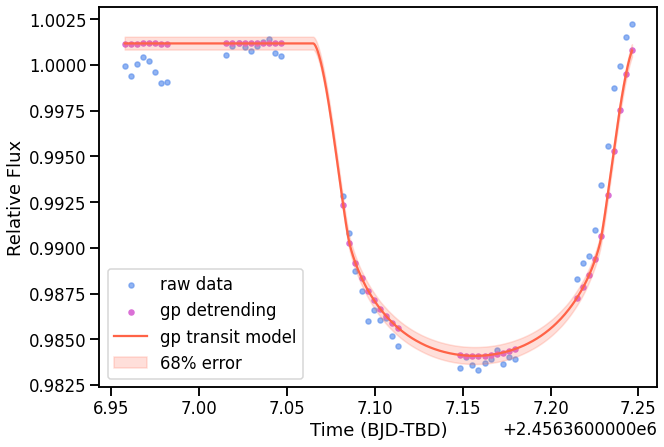

In [29]:
# let's plot the results of this fit using the juliet object
plt.figure(figsize = (10,7))
t_final = np.linspace(times_start_430[0], times_start_430[-1], 1000)
transit_plus_GP_model = gp_fit.lc.evaluate('STIS')
transit_model = gp_fit.lc.evaluate('STIS', evaluate_transit = True)
transit_model_resamp, error68_up, error68_down = gp_fit.lc.evaluate('STIS', evaluate_transit = True, t = t_final, return_err = True)

offset = 0
plt.scatter(times_start_430, (lc_430/np.median(lc_430[:10])), label = "raw data", color = "cornflowerblue", alpha = 0.7)
plt.scatter(times_start_430, (lc_430/np.median(lc_430[:10])) - (transit_plus_GP_model - transit_model) + offset,alpha=1, label = "gp detrending", color = "orchid")
plt.plot(np.linspace(times_start_430[0], times_start_430[-1], 1000), transit_model_resamp + offset, color='tomato',zorder=10, label = "gp transit model")
plt.fill_between(t_final, error68_up, error68_down, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Time (BJD-TBD)")
plt.show()

In [30]:
# second 430 transit
gp_fit_2 = white_light_fit(params_430, times_start_430_2, lc_430_2, lc_err_430_2, norm_pc_430_2, sys_method = "gp", juliet_name = "wasp-17_430_2", gp_kernel = "Matern", sampler = "dynamic_dynesty")


Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_2/_dynesty_DNS_posteriors.pkl


In [31]:
# here are the results for that fit
for i in gp_fit_2.posteriors['posterior_samples'].keys():
    print(i, np.median(gp_fit_2.posteriors['posterior_samples'][i]))

unnamed 0.5240453498220294
loglike 276.69891662381445
p_p1 0.12935740621572334
mflux_STIS 0.0007586221225874635
sigma_w_STIS 120.04275400681284
GP_sigma_STIS 221.25172065066673
GP_malpha0_STIS 0.5266538304822166
GP_malpha1_STIS 0.7748457930198941
GP_malpha2_STIS 0.47264818599741143
GP_malpha3_STIS 0.860191198862709
GP_malpha4_STIS 0.5751996595676532
GP_malpha5_STIS 0.3493854805165588
GP_malpha6_STIS 0.4885259619676662
GP_malpha7_STIS 0.3650071830062645
GP_malpha8_STIS 0.6811005980882461
GP_malpha9_STIS 0.5316058300512466


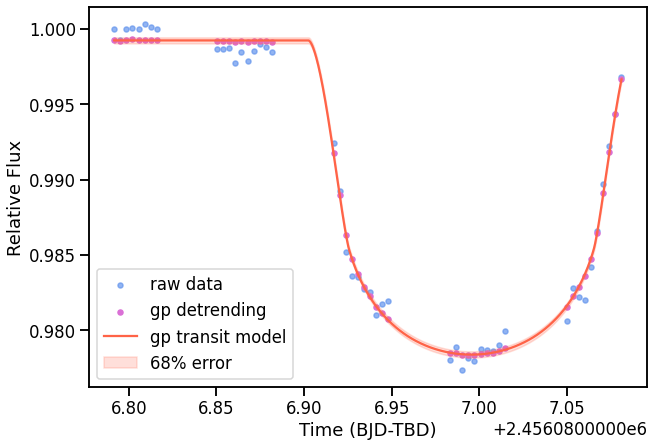

In [32]:
plt.figure(figsize = (10,7))
t_final = np.linspace(times_start_430_2[0], times_start_430_2[-1], 1000)

transit_plus_GP_model = gp_fit_2.lc.evaluate('STIS')
transit_model = gp_fit_2.lc.evaluate('STIS', evaluate_transit = True)
transit_model_resamp, error68_up, error68_down = gp_fit_2.lc.evaluate('STIS', evaluate_transit = True, t = t_final, return_err = True)

offset = 0
plt.scatter(times_start_430_2, (lc_430_2/np.median(lc_430_2[:10])), color = "cornflowerblue", alpha = 0.7, label = "raw data")
plt.scatter(times_start_430_2, (lc_430_2/np.median(lc_430_2[:10])) - (transit_plus_GP_model - transit_model) + offset,alpha=1, label = "gp detrending", color = "orchid")
plt.plot(t_final, transit_model_resamp + offset, color='tomato',zorder=10, label = "gp transit model")
plt.fill_between(t_final, error68_up, error68_down, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Time (BJD-TBD)")
plt.show()

In [33]:
# the 750 data, taking out the bad first orbit
gp_fit_750_nf = white_light_fit(params_750, times_start_750_less, lc_750_less, lc_err_750_less, norm_pc_750, sys_method = "gp", juliet_name = "wasp-17_750_nofirst", gp_kernel = "Matern", sampler = "dynamic_dynesty")


Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_nofirst/_dynesty_DNS_posteriors.pkl


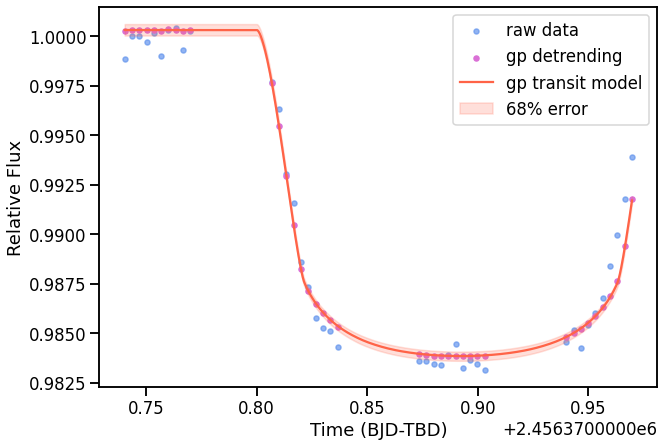

In [34]:
# better!
plt.figure(figsize = (10,7))
t_final = np.linspace(times_start_750_less[0], times_start_750_less[-1], 1000)
# then the gp detrending
transit_plus_GP_model = gp_fit_750_nf.lc.evaluate('STIS')
transit_model = gp_fit_750_nf.lc.evaluate('STIS', evaluate_transit = True)
transit_model_resamp, error68_up, error68_down = gp_fit_750_nf.lc.evaluate('STIS', evaluate_transit = True, t = t_final, return_err = True)

offset = 0
plt.scatter(times_start_750_less, (lc_750_less/np.median(lc_750_less[:10])), color = "cornflowerblue", alpha = 0.7, label = "raw data")
plt.scatter(times_start_750_less, (lc_750_less/np.median(lc_750_less[:10])) - (transit_plus_GP_model - transit_model) + offset,alpha=1, label = "gp detrending", color = "orchid")
#plt.plot(t_final, batman_model(t_final), color='black',zorder=10, label = "gp transit model (batman)")
plt.plot(t_final, transit_model_resamp + offset, color='tomato',zorder=10, label = "gp transit model")
plt.fill_between(t_final, error68_up, error68_down, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Time (BJD-TBD)")
plt.show()

In [35]:
# can also fit multiple 430 transits simultaneously
gp_fit_joint = joint_white_light_fit(params_430, times_start_430, lc_430, lc_err_430, norm_pc_use5_430, times_start_430_2, lc_430_2, lc_err_430_2, norm_pc_use5_430_2, sys_method = "gp", juliet_name = "wasp-17_430_joint", gp_kernel = "Matern", limb_darkening = "fixed", sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_joint/_dynesty_DNS_posteriors.pkl


In [36]:
for i in gp_fit_joint.posteriors['posterior_samples'].keys():
    print(i, np.median(gp_fit_joint.posteriors['posterior_samples'][i]))

unnamed 0.4487469874311104
loglike 529.4854959757815
p_p1 0.12690213682384416
mflux_STIS1 -0.002056704112213005
sigma_w_STIS1 530.3757873118817
GP_sigma_STIS1 771.0538838493342
mflux_STIS2 0.0008388492612272122
sigma_w_STIS2 22.88853007512512
GP_sigma_STIS2 387.5099533501427
GP_malpha0_STIS1 0.32903863915070775
GP_malpha1_STIS1 0.3378354275400864
GP_malpha2_STIS1 0.27984679594053735
GP_malpha3_STIS1 0.36279435690785816
GP_malpha4_STIS1 0.13378481885572371
GP_malpha0_STIS2 0.8322166039056226
GP_malpha1_STIS2 0.6099360911836847
GP_malpha2_STIS2 0.24011514322465072
GP_malpha3_STIS2 0.5551615164366562
GP_malpha4_STIS2 1.0868826024748457


(0.976, 1.004)

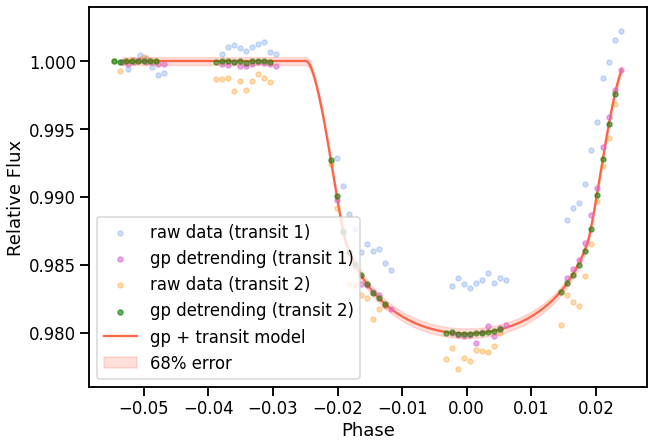

In [37]:
plt.figure(figsize = (10,7))

phases = juliet.utils.get_phases(times_start_430, params_430["P"], params_430["t0"])
phases_2 = juliet.utils.get_phases(times_start_430_2, params_430["P"], params_430["t0"])

transit_plus_GP_model1 = gp_fit_joint.lc.evaluate('STIS1')
transit_model1 = gp_fit_joint.lc.evaluate('STIS1', evaluate_transit = True)

gp_model1 = transit_plus_GP_model1 - transit_model1

transit_plus_GP_model2 = gp_fit_joint.lc.evaluate('STIS2')
transit_model2 = gp_fit_joint.lc.evaluate('STIS2', evaluate_transit = True)

gp_model2 = transit_plus_GP_model2 - transit_model2

offset1 = np.nanmedian(gp_fit_joint.posteriors['posterior_samples']['mflux_STIS1'])
offset2 = np.nanmedian(gp_fit_joint.posteriors['posterior_samples']['mflux_STIS2'])

t_final = np.linspace(times_start_430[0], times_start_430[-1], 1000)
transit_model2_resamp, error68_up, error68_down = gp_fit_joint.lc.evaluate('STIS2', evaluate_transit = True, t = t_final, return_err = True)
model_phases = juliet.utils.get_phases(t_final, params_430["P"], params_430["t0"])

offset3 = np.nanmedian(gp_fit_joint.posteriors['posterior_samples']['mflux_STIS2'])

plt.scatter(phases, (lc_430/np.median(lc_430[:10])),alpha=0.3, label = "raw data (transit 1)", color = "cornflowerblue",)
plt.scatter(phases, (lc_430/np.median(lc_430[:10])) - (transit_plus_GP_model1 - transit_model1) + offset1,alpha=0.6, label = "gp detrending (transit 1)", color = "orchid")

plt.scatter(phases_2, (lc_430_2/np.median(lc_430_2[:10])),alpha=0.3, label = "raw data (transit 2)", color = "darkorange",)
plt.scatter(phases_2, (lc_430_2/np.median(lc_430_2[:10])) - (transit_plus_GP_model2 - transit_model2) + offset2,alpha=0.6, label = "gp detrending (transit 2)", color = "green")

plt.plot(model_phases, transit_model2_resamp + offset3, color = "tomato", label = "gp + transit model", zorder = 0)
plt.fill_between(model_phases, error68_up+offset3, error68_down+offset3, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Phase")
plt.ylim(0.976, 1.004)

In [38]:
# any fit can also be done with linear detrending in the same way, just setting "sys_method" = "linear"
linear_fit_joint = joint_white_light_fit(params_430, times_start_430, lc_430, lc_err_430, norm_pc_use2_430, times_start_430_2, lc_430_2, lc_err_430_2, norm_pc_use2_430_2, sys_method = "linear", juliet_name = "wasp-17_430_joint_linear", limb_darkening = "fixed", sampler = "dynamic_dynesty")

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_joint_linear/_dynesty_DNS_posteriors.pkl


In [39]:
for i in linear_fit_joint.posteriors['posterior_samples'].keys():
    print(i, np.median(linear_fit_joint.posteriors['posterior_samples'][i]))

unnamed 0.00026467802686624964
loglike 521.2398504258299
p_p1 0.1258029849849958
mflux_STIS1 -0.002351432851907432
sigma_w_STIS1 1481.1854022597247
mflux_STIS2 0.0013520799232472572
sigma_w_STIS2 742.801937513526
theta0_STIS1 -0.0005097771021098652
theta1_STIS1 -0.0008465286518060111
theta0_STIS2 -0.0004487099193255517
theta1_STIS2 0.00026453538310988733


(0.976, 1.004)

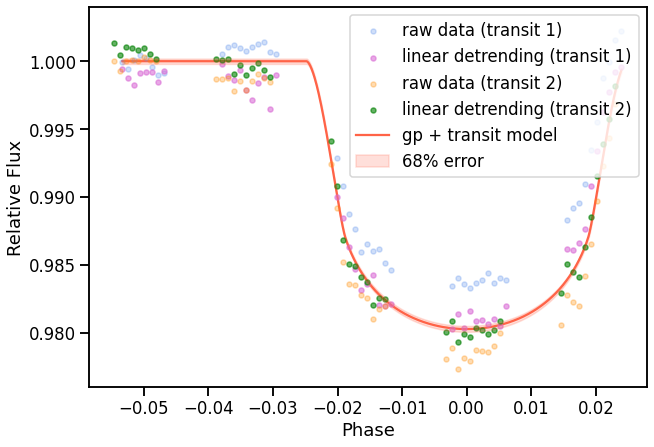

In [40]:
plt.figure(figsize = (10,7))

phases = juliet.utils.get_phases(times_start_430, params_430["P"], params_430["t0"])
phases_2 = juliet.utils.get_phases(times_start_430_2, params_430["P"], params_430["t0"])

transit_plus_GP_model1 = linear_fit_joint.lc.evaluate('STIS1')
transit_model1 = linear_fit_joint.lc.evaluate('STIS1', evaluate_transit = True)

gp_model1 = transit_plus_GP_model1 - transit_model1

transit_plus_GP_model2 = linear_fit_joint.lc.evaluate('STIS2')
transit_model2 = linear_fit_joint.lc.evaluate('STIS2', evaluate_transit = True)

gp_model2 = transit_plus_GP_model2 - transit_model2

offset1 = np.nanmedian(linear_fit_joint.posteriors['posterior_samples']['mflux_STIS1'])
offset2 = np.nanmedian(linear_fit_joint.posteriors['posterior_samples']['mflux_STIS2'])

t_final = np.linspace(times_start_430[0], times_start_430[-1], 1000)
transit_model2_resamp, error68_up, error68_down = linear_fit_joint.lc.evaluate('STIS2', evaluate_transit = True, t = t_final, return_err = True)
model_phases = juliet.utils.get_phases(t_final, params_430["P"], params_430["t0"])

offset3 = np.nanmedian(linear_fit_joint.posteriors['posterior_samples']['mflux_STIS2'])

plt.scatter(phases, (lc_430/np.median(lc_430[:10])),alpha=0.3, label = "raw data (transit 1)", color = "cornflowerblue",)
plt.scatter(phases, (lc_430/np.median(lc_430[:10])) - (transit_plus_GP_model1 - transit_model1) + offset1,alpha=0.6, label = "linear detrending (transit 1)", color = "orchid")

plt.scatter(phases_2, (lc_430_2/np.median(lc_430_2[:10])),alpha=0.3, label = "raw data (transit 2)", color = "darkorange",)
plt.scatter(phases_2, (lc_430_2/np.median(lc_430_2[:10])) - (transit_plus_GP_model2 - transit_model2) + offset2,alpha=0.6, label = "linear detrending (transit 2)", color = "green")

plt.plot(model_phases, transit_model2_resamp + offset3, color = "tomato", label = "gp + transit model", zorder = 0)
plt.fill_between(model_phases, error68_up+offset3, error68_down+offset3, color = "tomato", alpha = 0.2, label = "68% error")

plt.legend()
plt.ylabel("Relative Flux")
plt.xlabel("Phase")
plt.ylim(0.976, 1.004)
#plt.savefig("w17b_linear_430.png", dpi = 300, facecolor = "white")

In [41]:
# next is spectroscopic light curve fitting
# spectroscopic fit params dictionary -- only difference is how you pass in the limb darkening info
params_430_spec = {"P": [3.7354858],"t0": [2454592.8011189], "p": [0.12, 0.05], "b": [0.268], "rho": [475.128], "ecc": [0], "omega": [90], "c1": [c1_430], "c2": [c2_430]}
params_750_spec = {"P": [3.7354858],"t0": [2454592.8011189], "p": [0.12, 0.05], "b": [0.268], "rho": [475.128], "ecc": [0], "omega": [90], "c1": [c1_750], "c2": [c2_750]}

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc5_phase/wasp-17_750_dd_less_pc5_pha

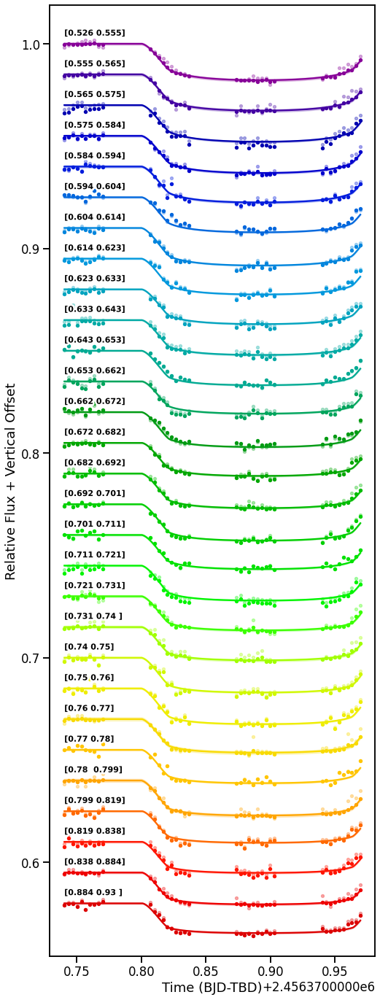

In [42]:
# the only difference for the spectroscopic light curve fitting function is that you pass in the wavelengths and 
# spectra itself rather than the light curve, and also the binning scheme (in a file, with the beginning
# and end wavelengths specified, see examples), and the "sld", which is the limb darkening object defined above
bins_7_nf_pc5_p, rp_7_nf_pc5_p, rp_e_7_nf_pc5_p, fits_7_dd_pc5_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use5_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "gp", juliet_name = "wasp-17_750_dd_less_pc5_phase",\
                                                    mode = 'HST_STIS_G750L', sampler = "dynamic_dynesty", plot = True, 
                                                    savefig = False)

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase/wasp-17_750_dd_less_pc2_linear_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase/wasp-17_750_dd_less_pc2_linear_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase/wasp-17_750_dd_less_pc2_linear_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase/wasp-17_750_dd_less_pc2_linear_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_750_dd_less_pc2_linear_phase/wasp-17_750_dd_less_pc2_linear_phase_bin005/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from

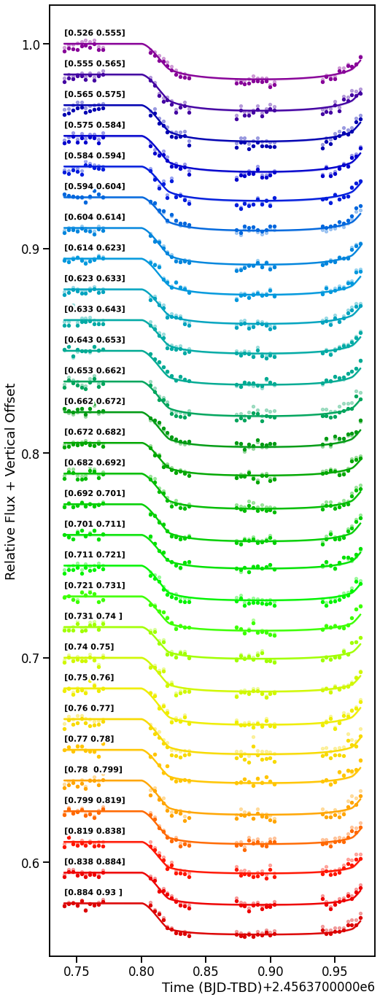

In [43]:
bins_7_nf_lin_pc2_p, rp_7_nf_lin_pc2_p, rp_e_7_nf_lin_pc2_p, fits_7_lin_dd_pc2_p = spectroscopic_lightcurve_fit(params_750_spec, order_750["WAVELENGTH"],\
                                                    times_start_750_less, spectra_750_less, norm_pc_use2_750,\
                                                    "wasp-121_g750_bins", sld,\
                                                    sys_method = "linear", juliet_name = "wasp-17_750_dd_less_pc2_linear_phase",\
                                                    mode = 'HST_STIS_G750L', sampler = "dynamic_dynesty", plot = True,
                                                    savefig = False)

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase/wasp-17_430_spec_PC5_d_dynesty_norm_fi

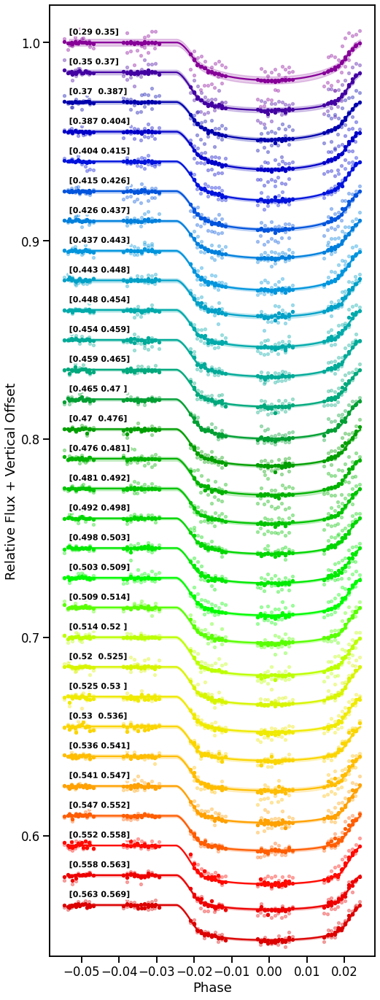

In [44]:
bins_joint_pc5_p, rp_joint_pc5_p, rp_e_joint_pc5_p, fits_pc5_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use5_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use5_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "gp", juliet_name = "wasp-17_430_spec_PC5_d_dynesty_norm_fixed_phase",\
                                                                      mode = 'HST_STIS_G430L', sampler = "dynamic_dynesty", plot = True,\
                                                                      savefig = False)

Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin001/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin002/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin003/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase/wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase_bin004/_dynesty_DNS_posteriors.pkl
Detected dynamic_dynesty sampler output files --- extracting from juliet_fits/wasp-17_430_spec_d_dynesty_nor

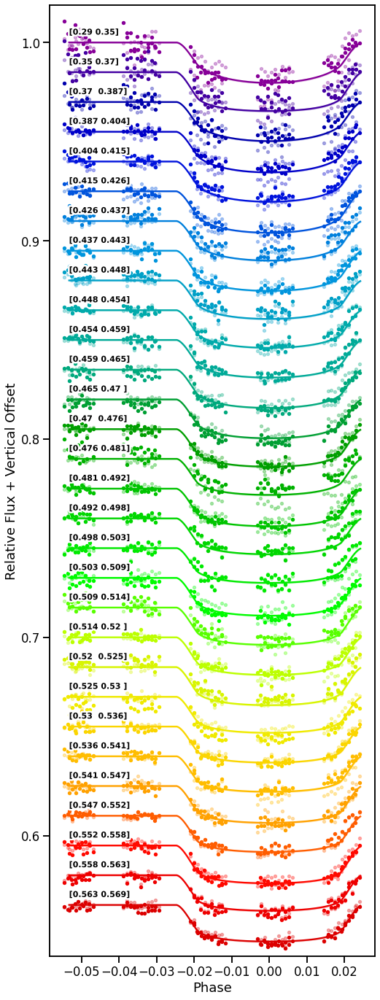

In [45]:
bins_joint_dd_lin_pc2_p, rp_joint_dd_lin_pc2_p, rp_e_joint_dd_lin_pc2_p, fits_lin_pc2_p = joint_spectroscopic_lightcurve_fit(params_430_spec, order_430["WAVELENGTH"],\
                                                                      times_start_430, spectra_430, norm_pc_use2_430,\
                                                                      times_start_430_2, spectra_430_2, norm_pc_use2_430_2,\
                                                                      "wasp-121_g430_bins", sld,\
                                                                      sys_method = "linear", juliet_name = "wasp-17_430_spec_d_dynesty_norm_fixed_linear_pc2_phase",\
                                                                      mode = 'HST_STIS_G430L', sampler = "dynamic_dynesty", plot = True,\
                                                                      savefig = False)
                                                                      

Text(0.5, 1.0, 'WASP-17 b')

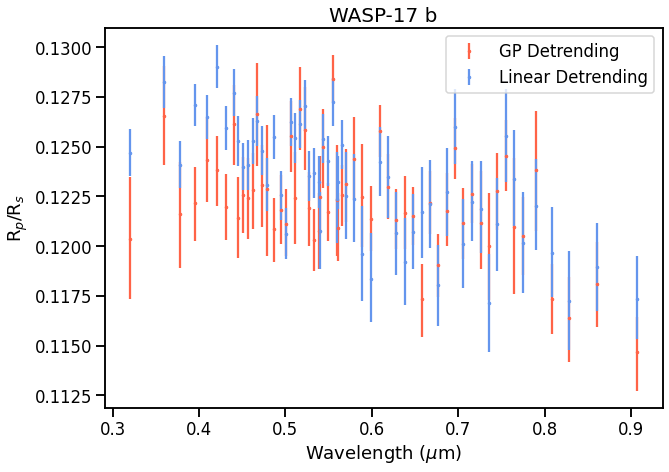

In [46]:
# final spectra!
plt.figure(figsize = (10,7))

plt.errorbar(np.array(bins_joint_pc5_p)/10000, rp_joint_pc5_p, yerr = np.array(rp_e_joint_pc5_p).T, fmt = ".", color = "tomato")
plt.errorbar(np.array(bins_7_nf_pc5_p)/10000, rp_7_nf_pc5_p, yerr = np.array(rp_e_7_nf_pc5_p).T, fmt = ".", color = "tomato", label = "GP Detrending")

plt.errorbar(np.array(bins_joint_dd_lin_pc2_p)/10000, rp_joint_dd_lin_pc2_p, yerr = np.array(rp_e_joint_dd_lin_pc2_p).T, fmt = ".", color = "cornflowerblue")
plt.errorbar(np.array(bins_7_nf_lin_pc2_p)/10000, rp_7_nf_lin_pc2_p, yerr = np.array(rp_e_7_nf_lin_pc2_p).T, fmt = ".", color = "cornflowerblue", label = "Linear Detrending")

plt.legend()
plt.ylabel(r"R$_p$/R$_s$")
plt.xlabel(r"Wavelength ($\mu$m)")
plt.title("WASP-17 b", fontsize=20)